## <center><h1>Credit Score Prediction </h1></center>

### PROBLEM STATEMENT

####   To predict a customer's credit score with improved accuracy and efficiency. By analyzing historical financial data and behavioral patterns. 

### INTRODUCTION

#### Credit score prediction is a crucial application in the financial industry, helping banks and financial institutions assess the creditworthiness of individuals. A credit score is a numerical representation of a borrower's ability to repay loans based on historical financial behavior.

### IMPORTING LIBRARIES

In [1]:
# for numerical data
import numpy as np
import pandas as pd

# for visualization
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

#labelencoder
from sklearn.preprocessing import LabelEncoder,OneHotEncoder

from scipy.stats import zscore
import scipy

# for hypothesis testing
from scipy.stats import shapiro,normaltest,kstest,chi2_contingency

#train test split
from sklearn.model_selection import train_test_split

#for ignoring warning
import warnings
warnings.filterwarnings("ignore")

# vif 
from statsmodels.stats.outliers_influence import variance_inflation_factor

# Logistic regression
from sklearn.linear_model import LogisticRegression

#model traning 
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, GradientBoostingClassifier
from xgboost import XGBClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC

#model evaluation
from sklearn.metrics import accuracy_score, confusion_matrix, multilabel_confusion_matrix, classification_report
from sklearn.model_selection import train_test_split, GridSearchCV, RandomizedSearchCV

In [2]:
pip install xgboost

Note: you may need to restart the kernel to use updated packages.


### LOAD DATASET

In [3]:
df1=pd.read_csv(r"C:\Users\Nikita Raykar\Downloads\credit_score_cleaned_train.csv")
df=df1.head(2000)
df

,Month,Name,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Credit_History_Age,Total_Emi_Per_Month,Num_Bank_Accounts,Num_Credit_Card,...,Num_Of_Loan,Type_Of_Loan,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Amount_Invested_Monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
0,January,Aaron Maashoh,23,Scientist,19114.12,1824.8434,89,49.574947,3,4,...,4,"['Auto Loan', 'Credit-Builder Loan', 'Personal...",4,Good,809.98,26.822620,80.415300,High_spent_Small_value_payments,312.49408,High
1,February,Aaron Maashoh,23,Scientist,19114.12,1824.8434,93,49.574947,3,4,...,4,"['Auto Loan', 'Credit-Builder Loan', 'Personal...",4,Good,809.98,31.944960,118.280220,Low_spent_Large_value_payments,284.62915,High
2,March,Aaron Maashoh,23,Scientist,19114.12,1824.8434,91,49.574947,3,4,...,4,"['Auto Loan', 'Credit-Builder Loan', 'Personal...",4,Good,809.98,28.609352,81.699524,Low_spent_Medium_value_payments,331.20987,High
3,April,Aaron Maashoh,23,Scientist,19114.12,1824.8434,92,49.574947,3,4,...,4,"['Auto Loan', 'Credit-Builder Loan', 'Personal...",4,Good,809.98,31.377861,199.458070,Low_spent_Small_value_payments,223.45131,High
4,May,Aaron Maashoh,23,Scientist,19114.12,1824.8434,93,49.574947,3,4,...,4,"['Auto Loan', 'Credit-Builder Loan', 'Personal...",4,Good,809.98,24.797346,41.420155,High_spent_Medium_value_payments,341.48923,High
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,April,Alpere,33,Accountant,18969.19,1849.7659,96,0.000000,1,7,...,0,['No Loan'],2,Good,54.82,25.290200,131.781600,Low_spent_Small_value_payments,343.19498,Low
1996,May,Alpere,33,Accountant,18969.19,1849.7659,100,0.000000,1,7,...,0,['No Loan'],2,Good,54.82,25.162382,117.216770,Low_spent_Small_value_payments,357.75983,Low
1997,June,Alpere,33,Accountant,18969.19,1849.7659,98,0.000000,1,7,...,0,['No Loan'],2,Good,54.82,27.207150,74.645200,High_spent_Medium_value_payments,360.33140,Low
1998,July,Alpere,33,Accountant,18969.19,1849.7659,99,0.000000,1,7,...,0,['No Loan'],2,Good,54.82,37.389046,182.977800,Low_spent_Small_value_payments,291.99878,Medium


#### BASIC INFORMATION

In [4]:
# shape of data 
df.shape

(2000, 21)

In [5]:
# size of data
df.size

42000

In [6]:
df.index

RangeIndex(start=0, stop=2000, step=1)

In [7]:
df.columns

Index(['Month', 'Name', 'Age', 'Occupation', 'Annual_Income',
       'Monthly_Inhand_Salary', 'Credit_History_Age', 'Total_Emi_Per_Month',
       'Num_Bank_Accounts', 'Num_Credit_Card', 'Interest_Rate', 'Num_Of_Loan',
       'Type_Of_Loan', 'Num_Credit_Inquiries', 'Credit_Mix',
       'Outstanding_Debt', 'Credit_Utilization_Ratio',
       'Amount_Invested_Monthly', 'Payment_Behaviour', 'Monthly_Balance',
       'Credit_Score'],
      dtype='object')

In [8]:
df.axes

[RangeIndex(start=0, stop=2000, step=1),
 Index(['Month', 'Name', 'Age', 'Occupation', 'Annual_Income',
        'Monthly_Inhand_Salary', 'Credit_History_Age', 'Total_Emi_Per_Month',
        'Num_Bank_Accounts', 'Num_Credit_Card', 'Interest_Rate', 'Num_Of_Loan',
        'Type_Of_Loan', 'Num_Credit_Inquiries', 'Credit_Mix',
        'Outstanding_Debt', 'Credit_Utilization_Ratio',
        'Amount_Invested_Monthly', 'Payment_Behaviour', 'Monthly_Balance',
        'Credit_Score'],
       dtype='object')]

In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 21 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Month                     2000 non-null   object 
 1   Name                      2000 non-null   object 
 2   Age                       2000 non-null   int64  
 3   Occupation                2000 non-null   object 
 4   Annual_Income             2000 non-null   float64
 5   Monthly_Inhand_Salary     2000 non-null   float64
 6   Credit_History_Age        2000 non-null   int64  
 7   Total_Emi_Per_Month       2000 non-null   float64
 8   Num_Bank_Accounts         2000 non-null   int64  
 9   Num_Credit_Card           2000 non-null   int64  
 10  Interest_Rate             2000 non-null   int64  
 11  Num_Of_Loan               2000 non-null   int64  
 12  Type_Of_Loan              2000 non-null   object 
 13  Num_Credit_Inquiries      2000 non-null   int64  
 14  Credit_M

In [10]:
# descriptive stats
df.describe()

,Age,Annual_Income,Monthly_Inhand_Salary,Credit_History_Age,Total_Emi_Per_Month,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_Of_Loan,Num_Credit_Inquiries,Outstanding_Debt,Credit_Utilization_Ratio,Amount_Invested_Monthly,Monthly_Balance
count,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.00000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000
mean,33.354000,51548.693876,4300.503731,82.729500,110.575241,5.201500,5.313500,14.11200,3.380000,5.324000,1368.931840,32.251701,692.024886,410.820334
std,10.205036,39702.405054,3284.003146,32.764922,146.912484,2.699915,2.027134,8.90006,2.382948,4.033629,1117.901511,5.130047,2155.617098,215.281829
min,16.000000,7441.295000,468.770000,4.000000,0.000000,0.000000,1.000000,1.00000,0.000000,0.000000,35.540000,21.744883,0.000000,0.688299
25%,25.000000,19403.404000,1684.832000,59.000000,27.522823,3.000000,4.000000,7.00000,2.000000,2.000000,565.220000,28.078805,74.009327,272.920015
50%,33.000000,34418.830000,2936.138400,83.000000,64.001686,6.000000,5.000000,12.00000,3.000000,4.000000,1104.395000,32.279159,140.819650,345.616270
75%,41.000000,74647.400000,6300.581500,110.000000,149.897200,8.000000,7.000000,19.00000,5.000000,8.000000,1793.540000,36.591780,274.572660,481.993413
max,56.000000,173196.310000,14258.026000,143.000000,1320.549100,10.000000,11.000000,34.00000,9.000000,17.000000,4984.820000,46.194237,10000.000000,1419.318000


#### CHECK FOR MISSING VALUES

In [11]:
df.isna()

,Month,Name,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Credit_History_Age,Total_Emi_Per_Month,Num_Bank_Accounts,Num_Credit_Card,...,Num_Of_Loan,Type_Of_Loan,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Amount_Invested_Monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
0,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
1996,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
1997,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
1998,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


In [12]:
df.isna().sum()

Month                       0
Name                        0
Age                         0
Occupation                  0
Annual_Income               0
Monthly_Inhand_Salary       0
Credit_History_Age          0
Total_Emi_Per_Month         0
Num_Bank_Accounts           0
Num_Credit_Card             0
Interest_Rate               0
Num_Of_Loan                 0
Type_Of_Loan                0
Num_Credit_Inquiries        0
Credit_Mix                  0
Outstanding_Debt            0
Credit_Utilization_Ratio    0
Amount_Invested_Monthly     0
Payment_Behaviour           0
Monthly_Balance             0
Credit_Score                0
dtype: int64

In [13]:
df.duplicated().sum()

0

#### CHECK FOR DATATYPES

In [14]:
df.dtypes

Month                        object
Name                         object
Age                           int64
Occupation                   object
Annual_Income               float64
Monthly_Inhand_Salary       float64
Credit_History_Age            int64
Total_Emi_Per_Month         float64
Num_Bank_Accounts             int64
Num_Credit_Card               int64
Interest_Rate                 int64
Num_Of_Loan                   int64
Type_Of_Loan                 object
Num_Credit_Inquiries          int64
Credit_Mix                   object
Outstanding_Debt            float64
Credit_Utilization_Ratio    float64
Amount_Invested_Monthly     float64
Payment_Behaviour            object
Monthly_Balance             float64
Credit_Score                 object
dtype: object

#### VALUE COUNTS FOR CREDIT SCORE COLUMN 

In [15]:
class_counts = df['Credit_Score'].value_counts()
print('Class distribution:')
print(class_counts)

Class distribution:
Credit_Score
Medium    1038
Low        547
High       415
Name: count, dtype: int64


#### NUMERICAL DATA ANALYSIS

In [16]:
numerical_cols=['Age','Annual_Income','Monthly_Inhand_Salary', 'Credit_History_Age', 'Total_Emi_Per_Month','Num_Bank_Accounts', 
               'Num_Credit_Card', 'Interest_Rate', 'Num_Of_Loan', 'Num_Credit_Inquiries','Outstanding_Debt', 
               'Credit_Utilization_Ratio','Amount_Invested_Monthly', 'Monthly_Balance']
stat={}
for col in numerical_cols:
    stat[col]={
        "Mean":df[col].mean(),
        "Median":df[col].median(),
        "Mode":df[col].mode()[0],
        "Varience":df[col].var(),
        "Standard Deviation":df[col].std(),
        "Skewness":df[col].skew(),
        "Range":df[col].max()-df[col].min(),
        "IQR":df[col].quantile(0.75)-df[col].quantile(0.25)
    }
statistics=pd.DataFrame(stat)
statistics

,Age,Annual_Income,Monthly_Inhand_Salary,Credit_History_Age,Total_Emi_Per_Month,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_Of_Loan,Num_Credit_Inquiries,Outstanding_Debt,Credit_Utilization_Ratio,Amount_Invested_Monthly,Monthly_Balance
Mean,33.354000,5.154869e+04,4.300504e+03,82.729500,110.575241,5.201500,5.313500,14.112000,3.380000,5.324000,1.368932e+03,32.251701,6.920249e+02,410.820334
Median,33.000000,3.441883e+04,2.936138e+03,83.000000,64.001686,6.000000,5.000000,12.000000,3.000000,4.000000,1.104395e+03,32.279159,1.408196e+02,345.616270
Mode,19.000000,7.441295e+03,4.687700e+02,76.000000,0.000000,8.000000,5.000000,6.000000,2.000000,2.000000,3.554000e+01,21.744883,1.000000e+04,161.193020
Varience,104.142755,1.576281e+09,1.078468e+07,1073.540100,21583.277885,7.289543,4.109272,79.211062,5.678439,16.270159,1.249704e+06,26.317387,4.646685e+06,46346.265947
Standard Deviation,10.205036,3.970241e+04,3.284003e+03,32.764922,146.912484,2.699915,2.027134,8.900060,2.382948,4.033629,1.117902e+03,5.130047,2.155617e+03,215.281829
Skewness,0.161681,9.735186e-01,9.585394e-01,-0.221785,3.757036,-0.200849,0.274341,0.632255,0.426237,0.619544,1.294143e+00,0.021108,4.056624e+00,1.342801
Range,40.000000,1.657550e+05,1.378926e+04,139.000000,1320.549100,10.000000,10.000000,33.000000,9.000000,17.000000,4.949280e+03,24.449354,1.000000e+04,1418.629701
IQR,16.000000,5.524400e+04,4.615749e+03,51.000000,122.374377,5.000000,3.000000,12.000000,3.000000,6.000000,1.228320e+03,8.512975,2.005633e+02,209.073398


In [17]:
df.Interest_Rate.value_counts(dropna=False)

Interest_Rate
6     136
8     128
5     128
12    112
15     96
11     88
7      88
14     88
31     80
17     80
18     72
10     72
20     72
9      72
3      56
16     56
1      56
32     48
4      48
25     48
2      48
19     40
13     40
29     40
24     32
28     32
34     24
26     24
21     24
33     24
23     16
27     16
30      8
22      8
Name: count, dtype: int64

#### UNIVARIENT ANALYSIS (SINGLE COLUMN)

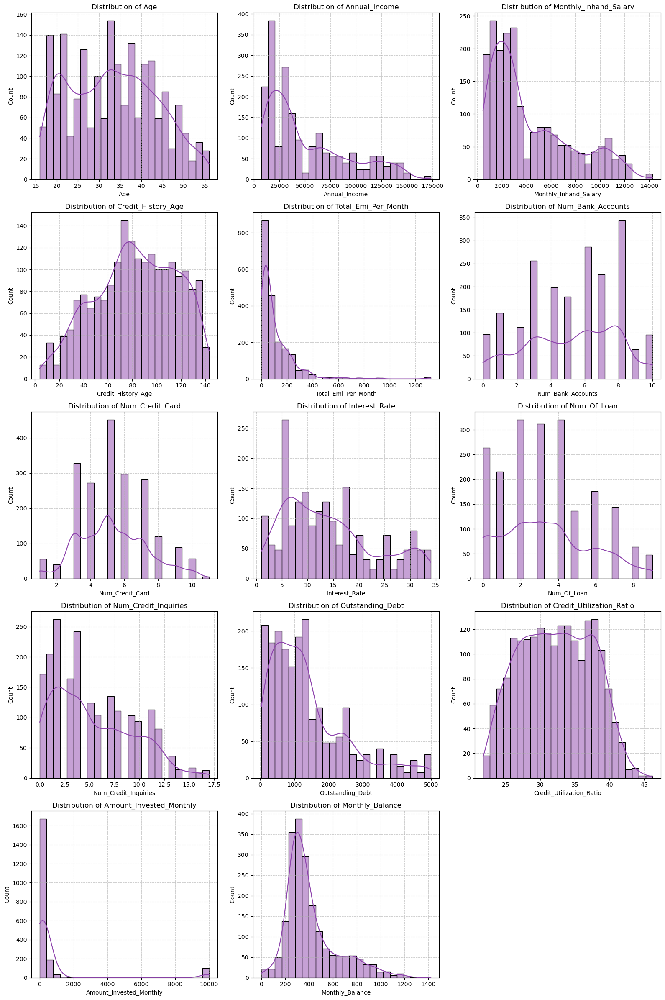

In [18]:
num_cols=['Age','Annual_Income','Monthly_Inhand_Salary', 'Credit_History_Age', 'Total_Emi_Per_Month',
          'Num_Bank_Accounts', 'Num_Credit_Card', 'Interest_Rate', 'Num_Of_Loan', 'Num_Credit_Inquiries',
          'Outstanding_Debt', 'Credit_Utilization_Ratio','Amount_Invested_Monthly', 'Monthly_Balance']

fig, axes = plt.subplots(5, 3, figsize=(16, 24))
axes = axes.flatten()

for i, col in enumerate(num_cols):
    sns.histplot(df[col], kde=True, bins=25, color="#8E44AD", edgecolor="black", ax=axes[i])    
    axes[i].set_title(f"Distribution of {col}")
    axes[i].grid(True, linestyle="--", alpha=0.6)

# Hide the last subplot (15th box) as we have only 14 plots
if len(num_cols) < len(axes):
    axes[-1].axis("off")

plt.tight_layout()
plt.show()


#### BOXENPLOT

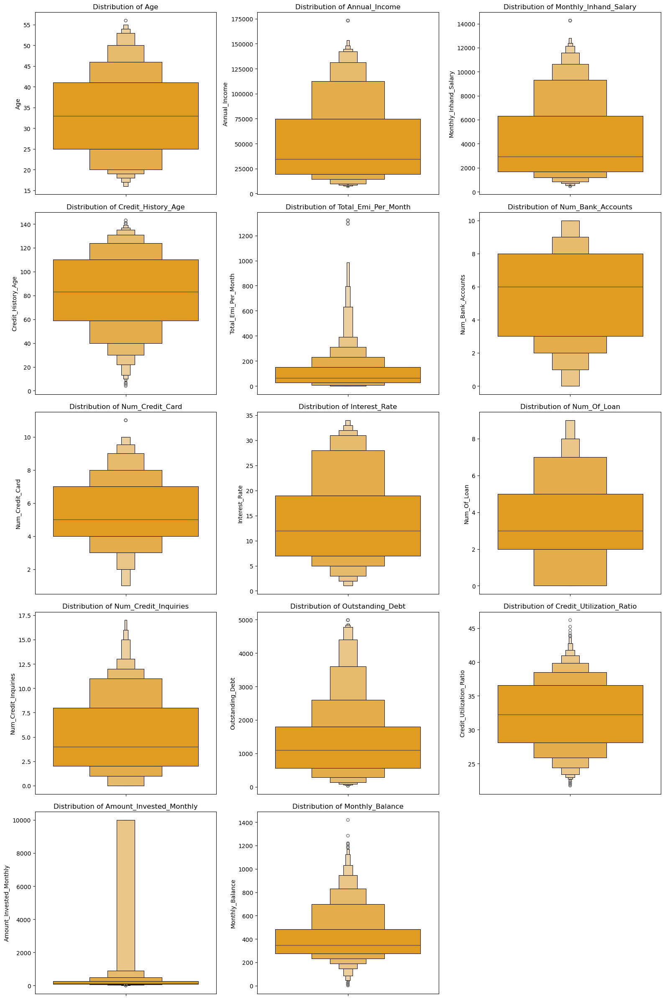

In [19]:
num_cols=['Age','Annual_Income','Monthly_Inhand_Salary', 'Credit_History_Age', 'Total_Emi_Per_Month','Num_Bank_Accounts', 
               'Num_Credit_Card', 'Interest_Rate', 'Num_Of_Loan', 'Num_Credit_Inquiries','Outstanding_Debt', 
               'Credit_Utilization_Ratio','Amount_Invested_Monthly', 'Monthly_Balance']
fig, axes = plt.subplots(5,3,figsize=(16,24))
axes = axes.flatten()
for i, col in enumerate(num_cols):
    sns.boxenplot(df[col],color="orange", edgecolor="black", ax=axes[i])    
    axes[i].set_title(f"Distribution of {col}")
    
# Hide the last subplot (15th box) as we have only 14 plots
if len(num_cols) < len(axes):
    axes[-1].axis("off")

plt.tight_layout()
plt.show()

#### KDEPLOT

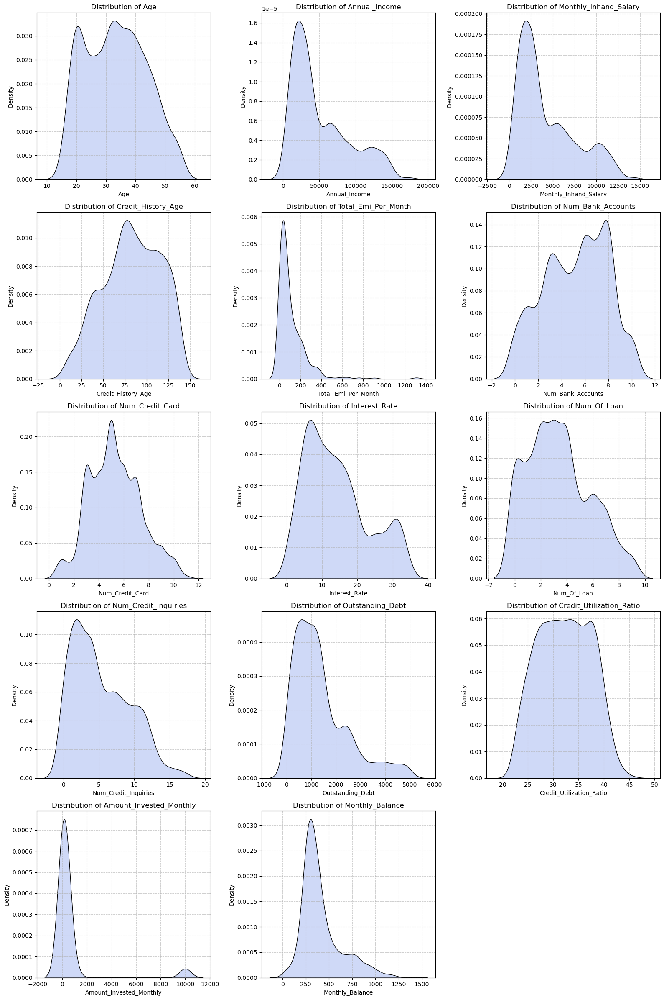

In [20]:
num_cols=['Age','Annual_Income','Monthly_Inhand_Salary', 'Credit_History_Age', 'Total_Emi_Per_Month','Num_Bank_Accounts', 
               'Num_Credit_Card', 'Interest_Rate', 'Num_Of_Loan', 'Num_Credit_Inquiries','Outstanding_Debt', 
               'Credit_Utilization_Ratio','Amount_Invested_Monthly', 'Monthly_Balance']
fig, axes = plt.subplots(5,3,figsize=(16,24))
axes = axes.flatten()
for i, col in enumerate(num_cols):
    sns.kdeplot(df[col], fill=True, color="royalblue",edgecolor="black", ax=axes[i])
    axes[i].set_title(f"Distribution of {col}")
    axes[i].grid(True, linestyle="--", alpha=0.6)
    
# Hide the last subplot (15th box) as we have only 14 plots
if len(num_cols) < len(axes):
    axes[-1].axis("off")

plt.tight_layout()
plt.show()

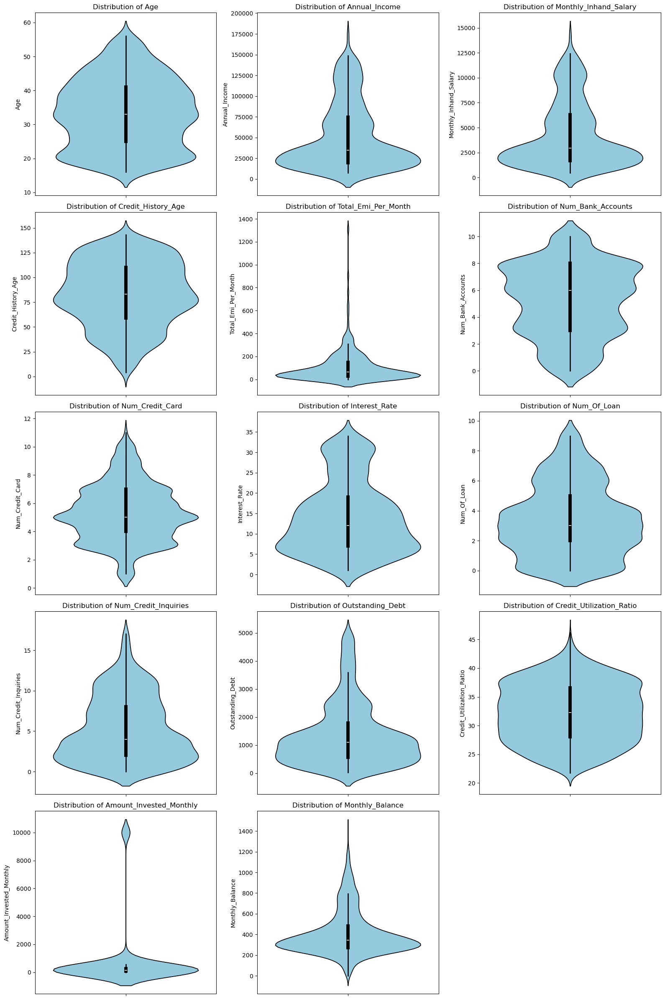

In [21]:
num_cols=['Age','Annual_Income','Monthly_Inhand_Salary', 'Credit_History_Age', 'Total_Emi_Per_Month','Num_Bank_Accounts', 
               'Num_Credit_Card', 'Interest_Rate', 'Num_Of_Loan', 'Num_Credit_Inquiries','Outstanding_Debt', 
               'Credit_Utilization_Ratio','Amount_Invested_Monthly', 'Monthly_Balance']
fig, axes = plt.subplots(5,3,figsize=(16,24))
axes = axes.flatten()
for i, col in enumerate(num_cols):
    sns.violinplot(df[col],edgecolor="black",color="skyblue", ax=axes[i])
    axes[i].set_title(f"Distribution of {col}")
# Hide the last subplot (15th box) as we have only 14 plots
if len(num_cols) < len(axes):
    axes[-1].axis("off")

plt.tight_layout()
plt.show()

#### STRIPPLOT

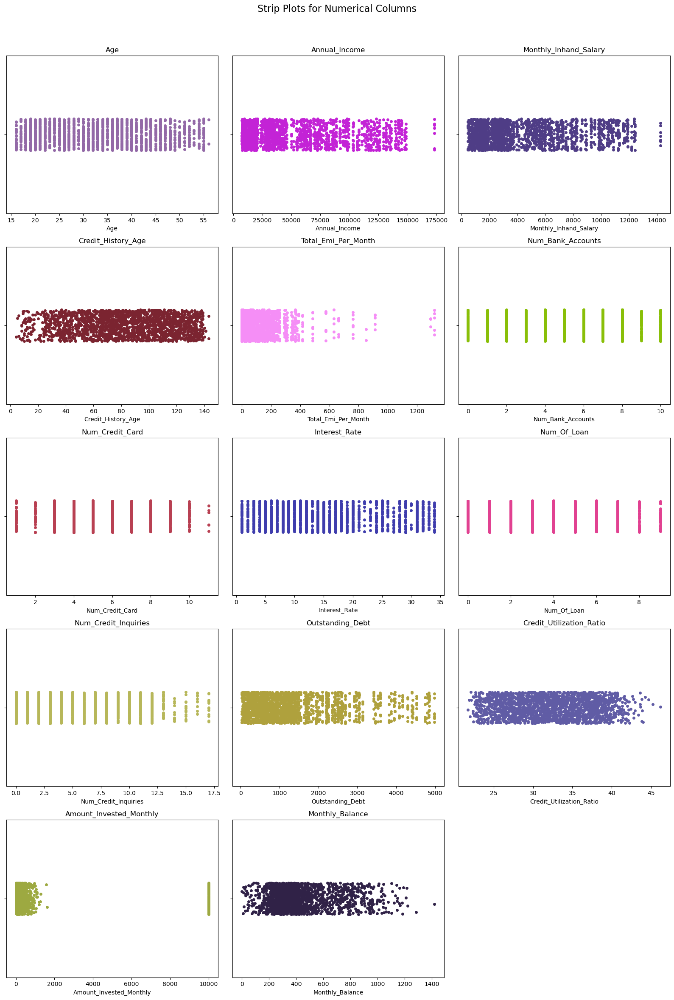

In [22]:
def random_hex_color():
    return "#{:06x}".format(np.random.randint(0, 0xFFFFFF))

# Create a 2x2 grid for strip plots
fig, axes = plt.subplots(5, 3, figsize=(16, 24))
fig.suptitle('Strip Plots for Numerical Columns', fontsize=16)

# Flatten axes array for easy iteration
axes = axes.flatten()

# Loop through numerical columns and create strip plots
for i, col in enumerate(num_cols):
    if i < len(axes):  # Ensure we don't exceed available subplots
        sns.stripplot(x=df[col], ax=axes[i], color=random_hex_color(), jitter=True)
        axes[i].set_title(col)
# Hide the last subplot (15th box) as we have only 14 plots
if len(num_cols) < len(axes):
    axes[-1].axis("off")

# Adjust layout to prevent overlapping
plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leaves space for suptitle
plt.show()

### Scatterplot

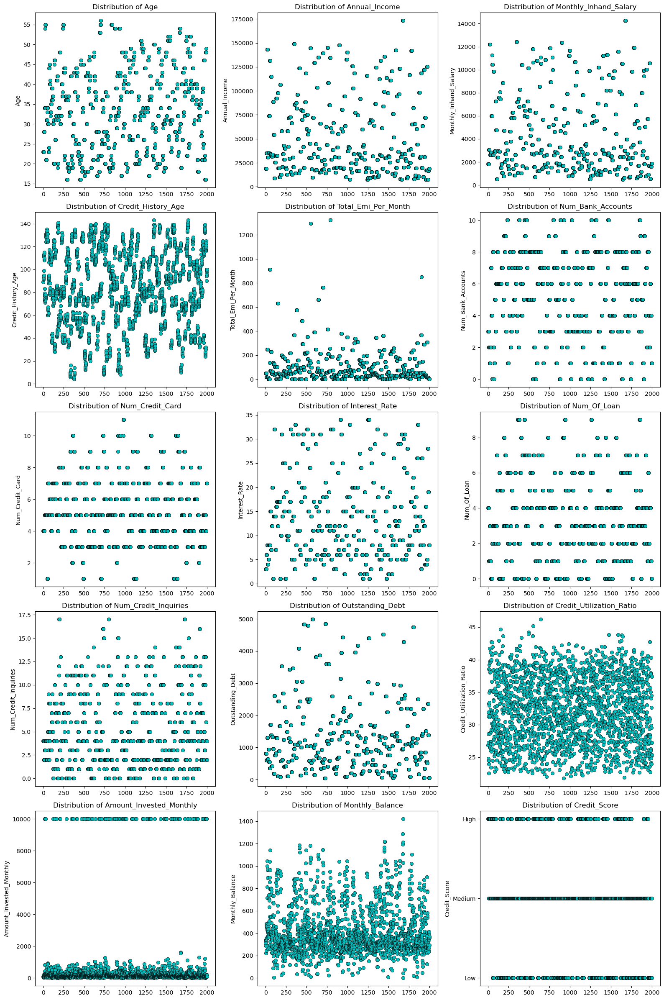

In [23]:
num_cols=['Age','Annual_Income','Monthly_Inhand_Salary', 'Credit_History_Age', 'Total_Emi_Per_Month','Num_Bank_Accounts', 
               'Num_Credit_Card', 'Interest_Rate', 'Num_Of_Loan', 'Num_Credit_Inquiries','Outstanding_Debt', 
               'Credit_Utilization_Ratio','Amount_Invested_Monthly', 'Monthly_Balance','Credit_Score']
fig, axes = plt.subplots(5,3,figsize=(16,24))
axes = axes.flatten()
for i, col in enumerate(num_cols):
    sns.scatterplot(df[col],edgecolor="black",color="c", ax=axes[i])
    axes[i].set_title(f"Distribution of {col}")
    
# Hide the last subplot (15th box) as we have only 14 plots
if len(num_cols) < len(axes):
    axes[-1].axis("off")
plt.tight_layout()
plt.show()

#### COVARINCE

In [24]:
df_numeric = df.select_dtypes(include=['number'])  
df_numeric.cov()

,Age,Annual_Income,Monthly_Inhand_Salary,Credit_History_Age,Total_Emi_Per_Month,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_Of_Loan,Num_Credit_Inquiries,Outstanding_Debt,Credit_Utilization_Ratio,Amount_Invested_Monthly,Monthly_Balance
Age,104.142755,-4.090831e+04,-3.381329e+03,31.445480,-1.807609e+02,-2.886274,-1.023991,-13.929113,-3.182611,-4.264328,-1.863345e+03,-1.826109,1.940385e+02,-4.746695e+01
Annual_Income,-40908.313253,1.576281e+09,1.301358e+08,432705.707268,3.263017e+06,-28521.751088,-19494.952410,-91838.501609,-18887.185125,-49434.657512,-8.771677e+06,32768.870440,5.947599e+06,6.008133e+06
Monthly_Inhand_Salary,-3381.329108,1.301358e+08,1.078468e+07,36084.589296,2.602820e+05,-2391.621027,-1626.326005,-7793.566104,-1586.190134,-4140.832991,-7.460602e+05,2687.340728,4.997969e+05,4.972520e+05
Credit_History_Age,31.445480,4.327057e+05,3.608459e+04,1073.540100,-9.990252e+01,-39.253121,-31.329863,-174.087248,-49.068744,-83.253485,-2.387108e+04,12.128291,2.499949e+03,2.579189e+03
Total_Emi_Per_Month,-180.760869,3.263017e+06,2.602820e+05,-99.902519,2.158328e+04,0.812200,-0.025648,134.715118,101.473874,16.960750,1.946821e+04,45.777520,4.809027e+03,6.844825e+03
Num_Bank_Accounts,-2.886274,-2.852175e+04,-2.391621e+03,-39.253121,8.122001e-01,7.289543,2.179920,14.364114,3.024442,5.904666,1.384977e+03,-0.556263,-3.841078e+02,-1.706528e+02
Num_Credit_Card,-1.023991,-1.949495e+04,-1.626326e+03,-31.329863,-2.564830e-02,2.179920,4.109272,8.324550,2.289515,4.288570,1.190336e+03,-0.422621,-6.188835e+01,-1.219393e+02
Interest_Rate,-13.929113,-9.183850e+04,-7.793566e+03,-174.087248,1.347151e+02,14.364114,8.324550,79.211062,13.015948,24.186805,6.557197e+03,-1.237726,-6.805216e+02,-6.336163e+02
Num_Of_Loan,-3.182611,-1.888719e+04,-1.586190e+03,-49.068744,1.014739e+02,3.024442,2.289515,13.015948,5.678439,5.851306,1.750203e+03,-0.694653,-5.818253e+01,-2.093632e+02
Num_Credit_Inquiries,-4.264328,-4.943466e+04,-4.140833e+03,-83.253485,1.696075e+01,5.904666,4.288570,24.186805,5.851306,16.270159,2.928667e+03,-1.170509,-4.077074e+02,-3.047350e+02


#### CORRELATION

In [25]:
df_numeric.corr()

,Age,Annual_Income,Monthly_Inhand_Salary,Credit_History_Age,Total_Emi_Per_Month,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_Of_Loan,Num_Credit_Inquiries,Outstanding_Debt,Credit_Utilization_Ratio,Amount_Invested_Monthly,Monthly_Balance
Age,1.000000,-0.100967,-0.100895,0.094045,-0.120568,-0.104755,-0.049499,-0.153361,-0.130874,-0.103595,-0.163334,-0.034881,0.008821,-0.021606
Annual_Income,-0.100967,1.000000,0.998105,0.332634,0.559427,-0.266078,-0.242227,-0.259905,-0.199635,-0.308687,-0.197634,0.160888,0.069495,0.702935
Monthly_Inhand_Salary,-0.100895,0.998105,1.000000,0.335358,0.539488,-0.269736,-0.244299,-0.266649,-0.202692,-0.312599,-0.203220,0.159514,0.070602,0.703340
Credit_History_Age,0.094045,0.332634,0.335358,1.000000,-0.020754,-0.443726,-0.471701,-0.596987,-0.628465,-0.629937,-0.651718,0.072155,0.035396,0.365651
Total_Emi_Per_Month,-0.120568,0.559427,0.539488,-0.020754,1.000000,0.002048,-0.000086,0.103030,0.289855,0.028621,0.118540,0.060740,0.015185,0.216419
Num_Bank_Accounts,-0.104755,-0.266078,-0.269736,-0.443726,0.002048,1.000000,0.398298,0.597772,0.470090,0.542187,0.458869,-0.040161,-0.065998,-0.293600
Num_Credit_Card,-0.049499,-0.242227,-0.244299,-0.471701,-0.000086,0.398298,1.000000,0.461408,0.473965,0.524486,0.525271,-0.040639,-0.014163,-0.279418
Interest_Rate,-0.153361,-0.259905,-0.266649,-0.596987,0.103030,0.597772,0.461408,1.000000,0.613717,0.673736,0.659055,-0.027109,-0.035471,-0.330694
Num_Of_Loan,-0.130874,-0.199635,-0.202692,-0.628465,0.289855,0.470090,0.473965,0.613717,1.000000,0.608755,0.657007,-0.056824,-0.011327,-0.408111
Num_Credit_Inquiries,-0.103595,-0.308687,-0.312599,-0.629937,0.028621,0.542187,0.524486,0.673736,0.608755,1.000000,0.649487,-0.056566,-0.046890,-0.350929


### Multivarient Analysis

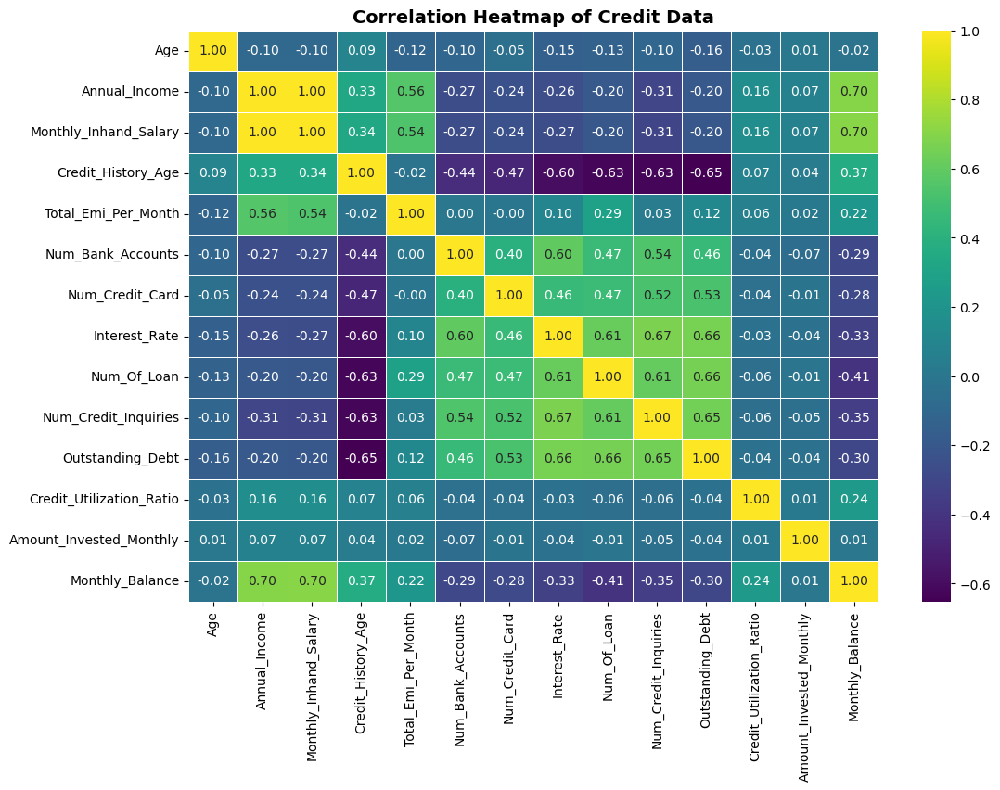

In [26]:
plt.figure(figsize=(12, 8))
sns.heatmap(df_numeric.corr(), annot=True, fmt=".2f", cmap="viridis", linewidths=0.5)
plt.title("Correlation Heatmap of Credit Data", fontsize=14, fontweight="bold")
plt.show()

<Axes: >

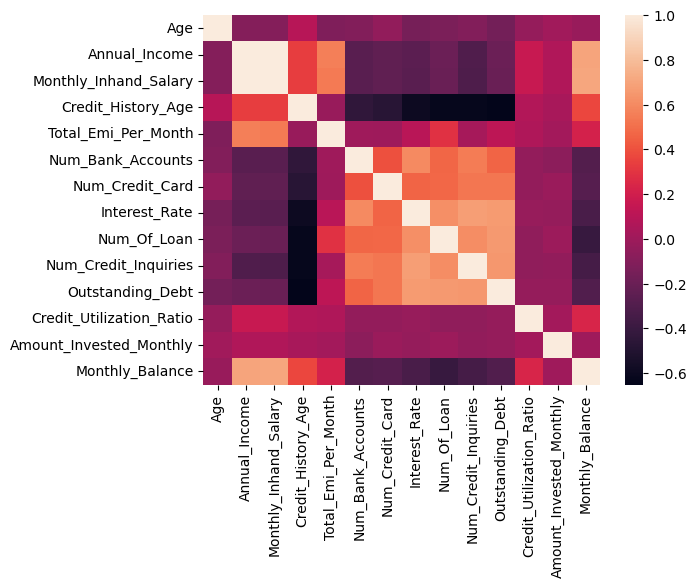

In [27]:
sns.heatmap(df_numeric.corr())

#### PAIRPLOT

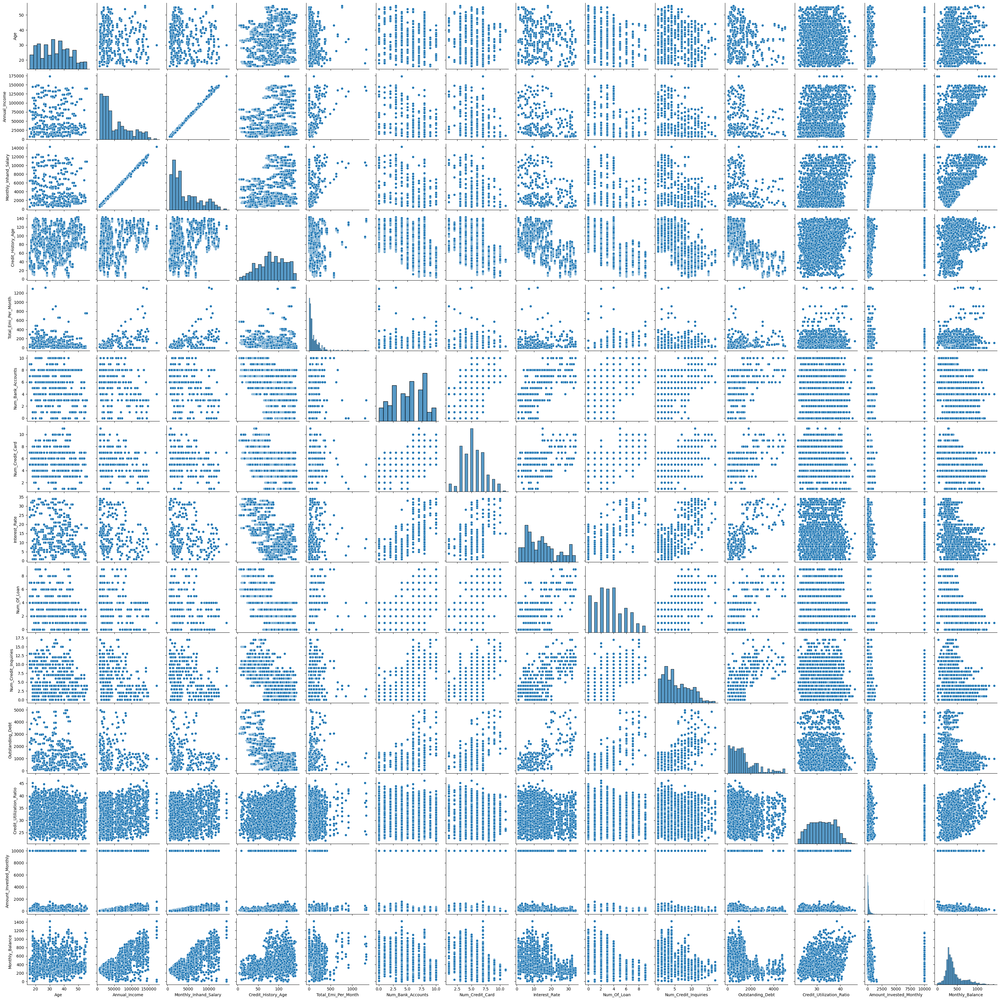

In [28]:
sns.pairplot(data=df)

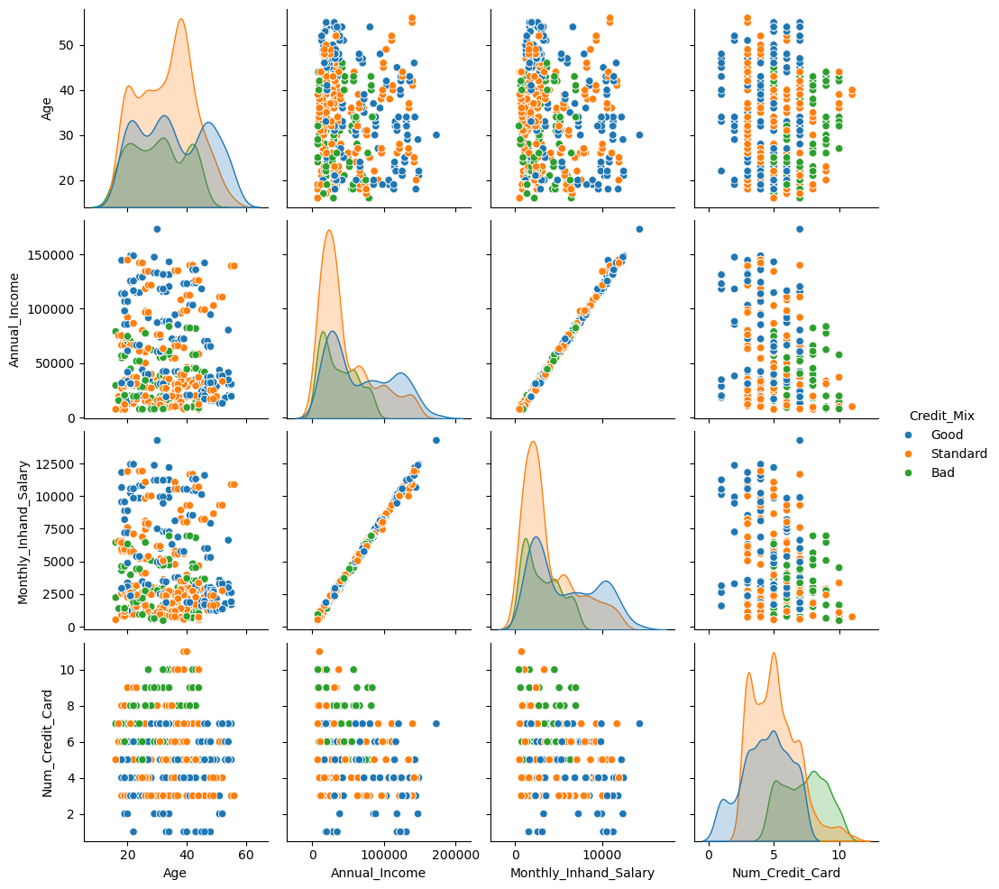

In [29]:
sns.pairplot(data=df,vars=["Age","Annual_Income","Monthly_Inhand_Salary","Num_Credit_Card"],hue="Credit_Mix",diag_kind="kde",palette="tab10")

#### CATEGORIAL COLUMN ANALYSIS

In [30]:
Categorial_cols=['Month','Name','Occupation','Type_Of_Loan','Credit_Mix','Payment_Behaviour','Credit_Score']

for col in Categorial_cols:
    print(f"\nAnalysis for :{col}")
    print(f"Unique :{df[col].unique()}"),
    print(f"Nunique :{df[col].nunique()}"),
    print(f"Value_counts :{df[col].value_counts()}"),
    print(f"Mode :{df[col].mode()[0]}")
    print("*"*50)
    


Analysis for :Month
Unique :['January' 'February' 'March' 'April' 'May' 'June' 'July' 'August']
Nunique :8
Value_counts :Month
January     250
February    250
March       250
April       250
May         250
June        250
July        250
August      250
Name: count, dtype: int64
Mode :April
**************************************************

Analysis for :Name
Unique :['Aaron Maashoh' 'Rick Rothackerj' 'Langep' 'Jasond' 'Deepaa' 'Np'
 'Nadiaq' 'Annk' 'Charlie Zhur' 'Jamesj' 'Saphirj' 'Soyoungd'
 'Harriet McLeodd' 'Sinead Carews' 'Poornimaf' 'Chalmersa' 'Parkm'
 'Patrickg' 'Laurence Frosty' 'Reema' 'Mark Felsenthald' 'Lee Chyenz'
 'Nickb' 'McBrideq' 'Rickt' 'Reijik' 'Ashleyk' 'Williamso'
 'Dhanya Skariachano' 'Sarahb' 'Mukhopadhyayc' 'Ayeshaz' 'Lisa Baertleinu'
 'Carlosj' 'Andreas Cremerf' 'Bri' 'ra Alperx' 'Matt Falloonz' 'Lawrencea'
 'Emily Flitterl' 'Nateg' 'Toonkeln' 'Jaisinghanij' 'Pomeroyi'
 'Olivia Oranr' 'Shupingu' '"John ODonnell"p' 'Scheydere' 'Nate Raymondj'
 'Edwardk' 'Kaz

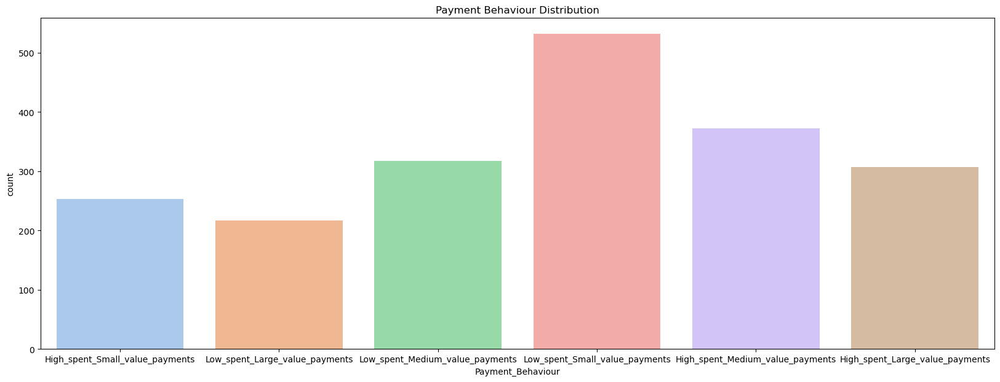

In [31]:
plt.figure(figsize=(20, 7))
sns.countplot(data=df, x='Payment_Behaviour', palette='pastel')
plt.title('Payment Behaviour Distribution')
plt.show()

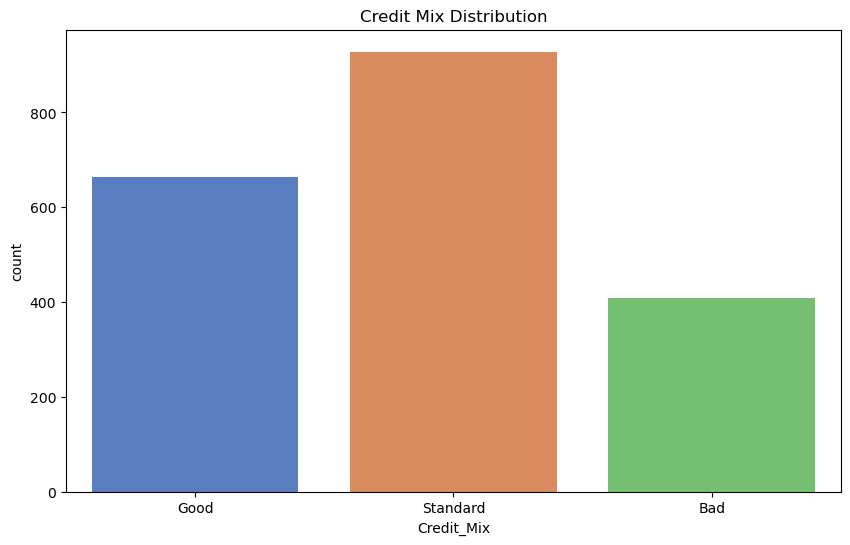

In [32]:
# 18. Credit Mix Distribution
plt.figure(figsize=(10, 6))
sns.countplot(data=df, x='Credit_Mix', palette='muted')
plt.title('Credit Mix Distribution')
plt.show()

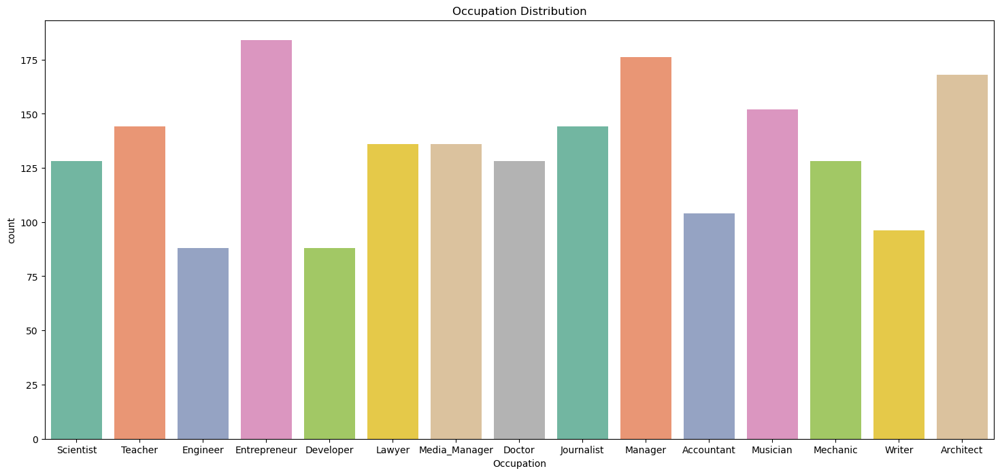

In [33]:
# Occupation Distribution
plt.figure(figsize=(18, 8))
sns.countplot(data=df, x='Occupation', palette='Set2')
plt.title('Occupation Distribution')
plt.show()

### MORE VISUALIZATION

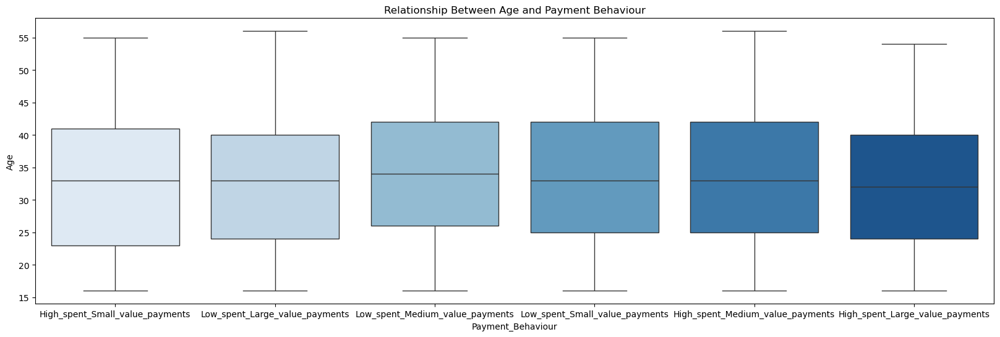

In [34]:
plt.figure(figsize=(20, 6))
sns.boxplot(x='Payment_Behaviour', y='Age', data=df, palette='Blues')
plt.title('Relationship Between Age and Payment Behaviour')
plt.show()

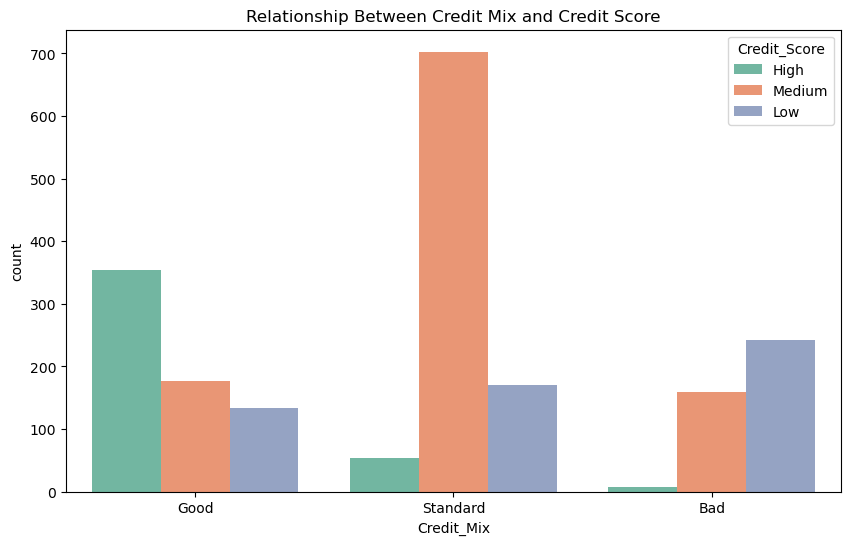

In [35]:
plt.figure(figsize=(10, 6))
sns.countplot(data=df, x='Credit_Mix', hue='Credit_Score', palette='Set2')
plt.title('Relationship Between Credit Mix and Credit Score')
plt.show()

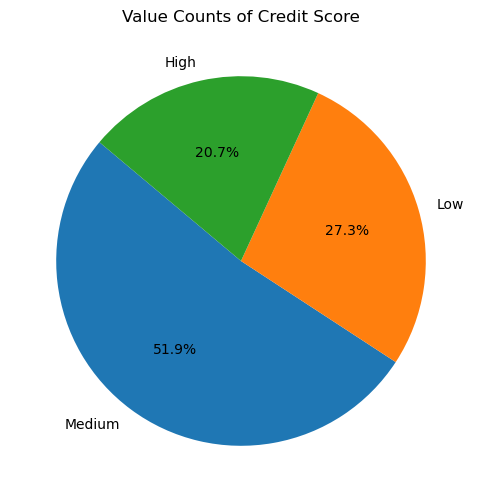

In [36]:
# Value Counts of Credit Score

Credit_Score_counts = df["Credit_Score"].value_counts()

plt.figure(figsize=(8, 6))
plt.pie(Credit_Score_counts.values, labels=Credit_Score_counts.index, autopct='%1.1f%%', startangle=140)
plt.title('Value Counts of Credit Score')

plt.show()

In [37]:
#Treemap of Occupation vs Annual Income

fig = px.treemap(df, path=["Occupation"], values="Annual_Income",title="Treemap of Occupation vs Annual Income",color="Annual_Income", color_continuous_scale="viridis")
fig.show()


In [38]:
#Average Annual Income by Occupation
import plotly.express as px

df_grouped = df.groupby("Occupation")["Annual_Income"].mean().reset_index()

fig = px.bar(df_grouped, x="Occupation", y="Annual_Income", 
             color="Annual_Income", 
             color_continuous_scale="Plasma",
             title="Average Annual Income by Occupation",
             hover_data=["Annual_Income"])
fig.show()


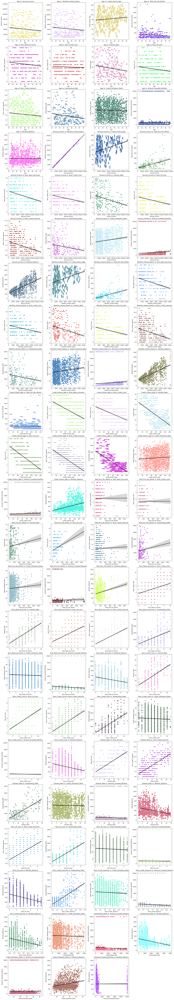

In [39]:
import itertools
def random_hex_color():
    return "#{:06x}".format(np.random.randint(0, 0xFFFFFF))

# Define numerical columns
num_cols = ['Age', 'Annual_Income', 'Monthly_Inhand_Salary', 'Credit_History_Age', 'Total_Emi_Per_Month', 
            'Num_Bank_Accounts', 'Num_Credit_Card', 'Interest_Rate', 'Num_Of_Loan', 'Num_Credit_Inquiries', 
            'Outstanding_Debt', 'Credit_Utilization_Ratio', 'Amount_Invested_Monthly', 'Monthly_Balance']

# Generate all possible numerical column pairs
combinations = list(itertools.combinations(num_cols, 2))

# Define grid layout for subplots
n_cols = 4
n_rows = (len(combinations) + n_cols - 1) // n_cols  # Calculate required rows

# Create subplots with optimized spacing
fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 5 * n_rows), constrained_layout=True)
axes = axes.flatten()

# Loop through column pairs and create scatter + regression plots
for i, (col1, col2) in enumerate(combinations):
    if i >= len(axes):  # Prevent index error if too many combinations
        break
    color = random_hex_color()  # Store color to keep scatter and line consistent
    sns.scatterplot(x=df[col1], y=df[col2], ax=axes[i], color=color)  # Scatter plot
    sns.regplot(x=df[col1], y=df[col2], ax=axes[i], scatter=False, color='black')  # Regression line
    axes[i].set_title(f'{col1} vs. {col2}', fontsize=12)

# Hide unused axes (if any)
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])
# Display plot
plt.show()

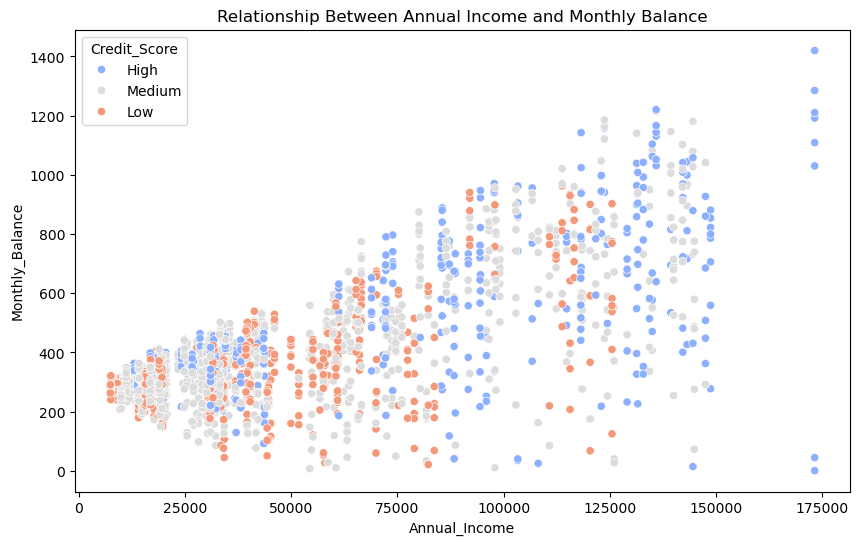

In [40]:
# Annual Income vs Monthly Balance
plt.figure(figsize=(10, 6))
sns.scatterplot(x='Annual_Income', y='Monthly_Balance', data=df, hue='Credit_Score', palette='coolwarm')
plt.title('Relationship Between Annual Income and Monthly Balance')
plt.show()

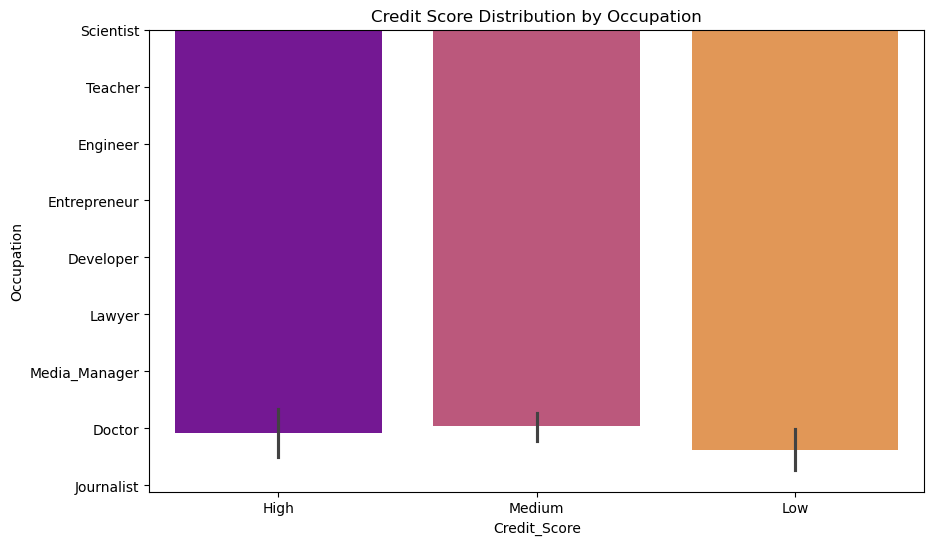

In [41]:
#Age Range vs Credit Score
plt.figure(figsize=(10,6))
sns.barplot(y="Occupation", x="Credit_Score", data=df,palette="plasma")
plt.title("Credit Score Distribution by Occupation")
plt.show()

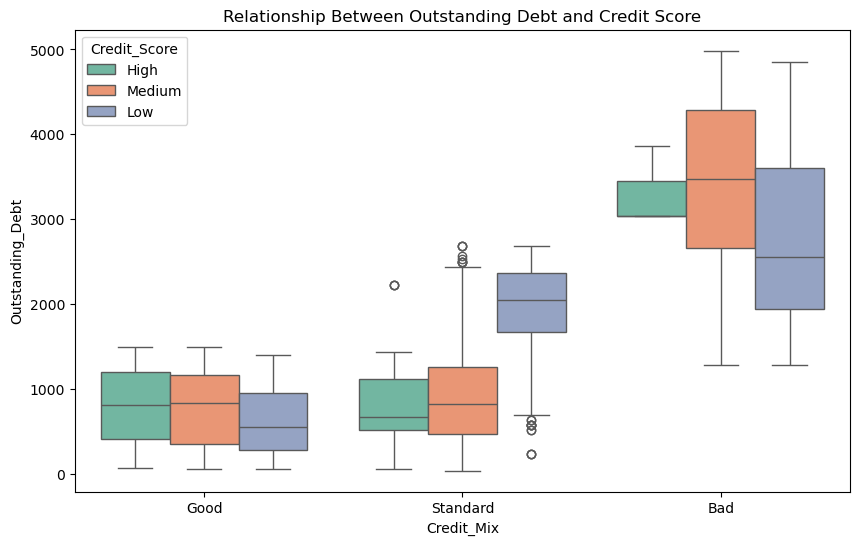

In [42]:
# outstanding Debt vs Credit Score 
plt.figure(figsize=(10, 6))
sns.boxplot(x='Credit_Mix', y='Outstanding_Debt', hue='Credit_Score', data=df, palette='Set2')
plt.title('Relationship Between Outstanding Debt and Credit Score')
plt.show()

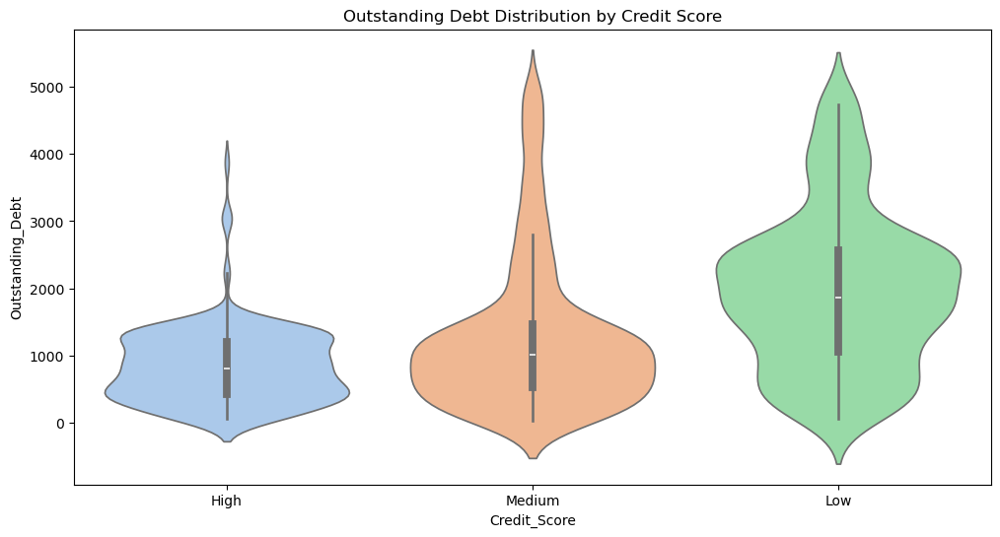

In [43]:
# Outstanding Debt Distribution by Credit Score
plt.figure(figsize=(12, 6))
sns.violinplot(data=df, x="Credit_Score", y="Outstanding_Debt", palette="pastel")
plt.title("Outstanding Debt Distribution by Credit Score")
plt.show()

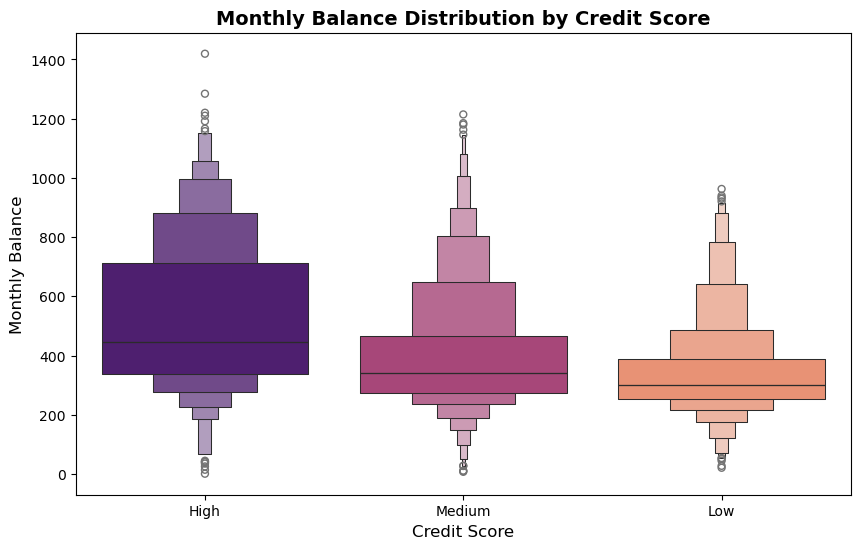

In [44]:
# Monthly Balance Distribution by Credit Score
plt.figure(figsize=(10, 6))
sns.boxenplot(x=df["Credit_Score"], y=df["Monthly_Balance"], palette="magma")
plt.title("Monthly Balance Distribution by Credit Score", fontsize=14, fontweight="bold")
plt.xlabel("Credit Score", fontsize=12)
plt.ylabel("Monthly Balance", fontsize=12)
plt.show()

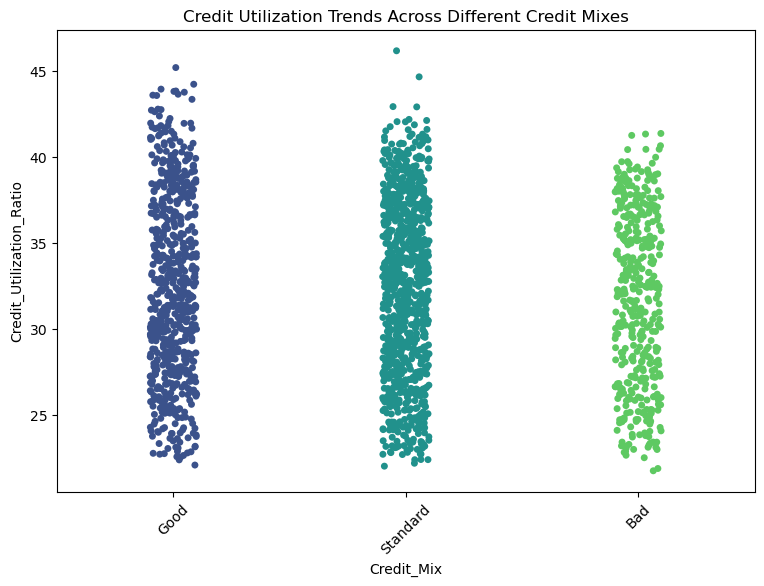

In [45]:
plt.figure(figsize=(9, 6))
sns.stripplot(x=df["Credit_Mix"], y=df["Credit_Utilization_Ratio"], palette="viridis")
plt.xticks(rotation=45)  
plt.title("Credit Utilization Trends Across Different Credit Mixes")
plt.show()

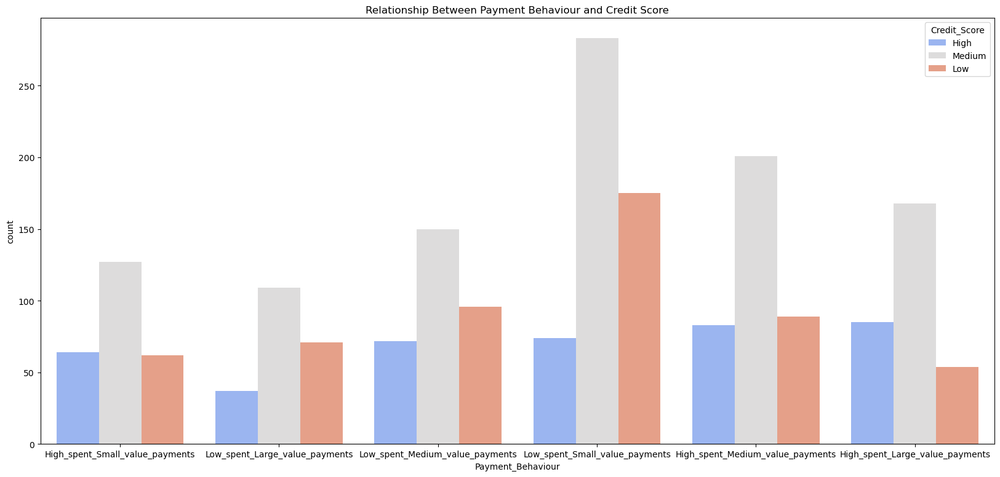

In [46]:
# Payment Behaviour vs Credit Score
plt.figure(figsize=(20, 9))
sns.countplot(data=df, x='Payment_Behaviour', hue='Credit_Score', palette="coolwarm")
plt.title('Relationship Between Payment Behaviour and Credit Score')
plt.show()

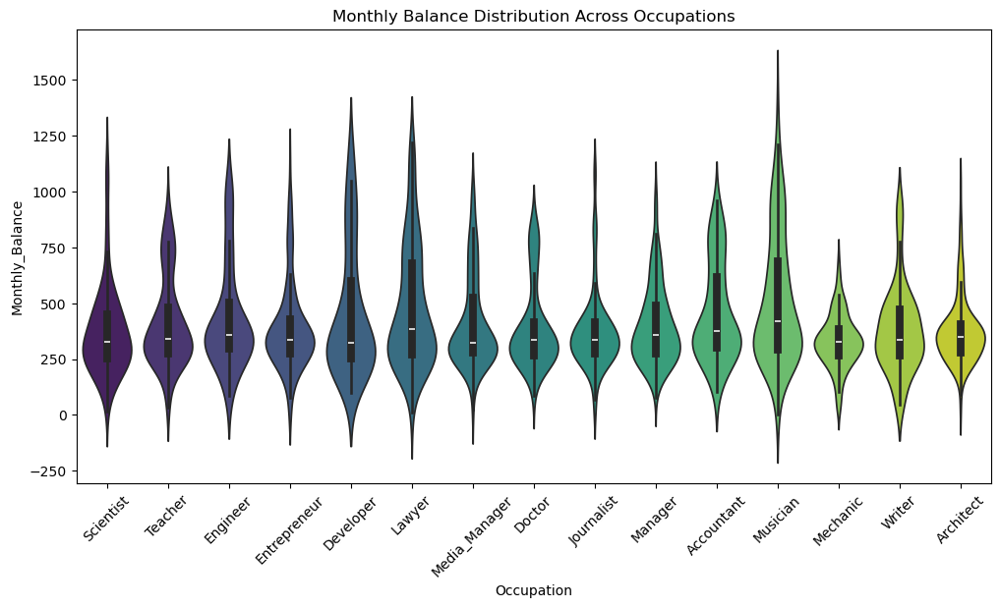

In [47]:
# Monthly Balance Distribution Across Occupations
plt.figure(figsize=(12, 6))
sns.violinplot(x=df["Occupation"], y=df["Monthly_Balance"], palette="viridis")
plt.xticks(rotation=45)  
plt.title("Monthly Balance Distribution Across Occupations")
plt.show()

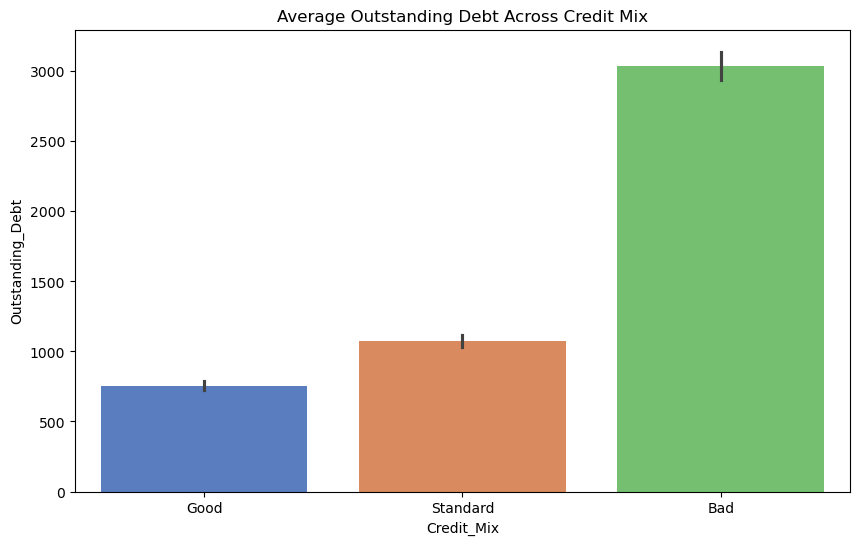

In [48]:
# Average Outstanding Debt Across Credit Mix
plt.figure(figsize=(10, 6))
sns.barplot(x=df["Credit_Mix"], y=df["Outstanding_Debt"], estimator=np.mean, palette="muted")
plt.title("Average Outstanding Debt Across Credit Mix")
plt.show()

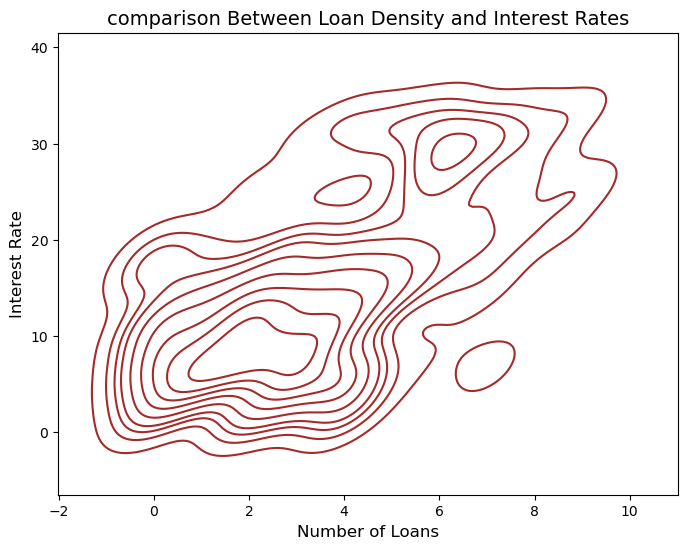

In [49]:
# Num_Of_Loan vs Interest Rate
plt.figure(figsize=(8, 6))
sns.kdeplot(x=df["Num_Of_Loan"], y=df["Interest_Rate"],color="Brown")

plt.xlabel("Number of Loans", fontsize=12)
plt.ylabel("Interest Rate", fontsize=12)
plt.title("comparison Between Loan Density and Interest Rates", fontsize=14)
plt.show()

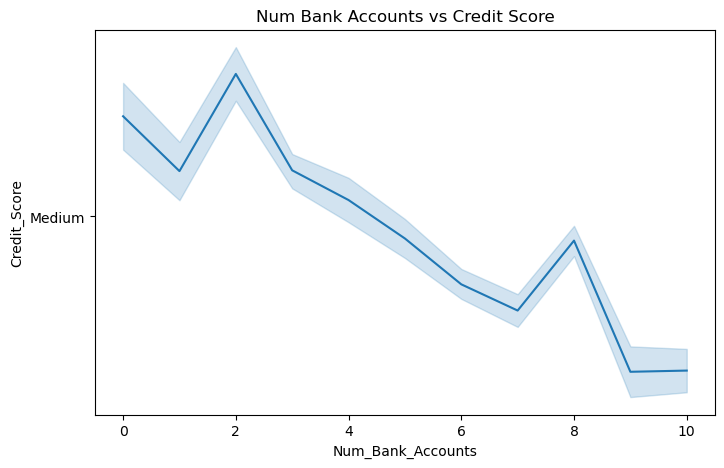

In [50]:
plt.figure(figsize=(8,5))
sns.lineplot(x="Num_Bank_Accounts", y="Credit_Score", data=df)
plt.title("Num Bank Accounts vs Credit Score")
plt.show()

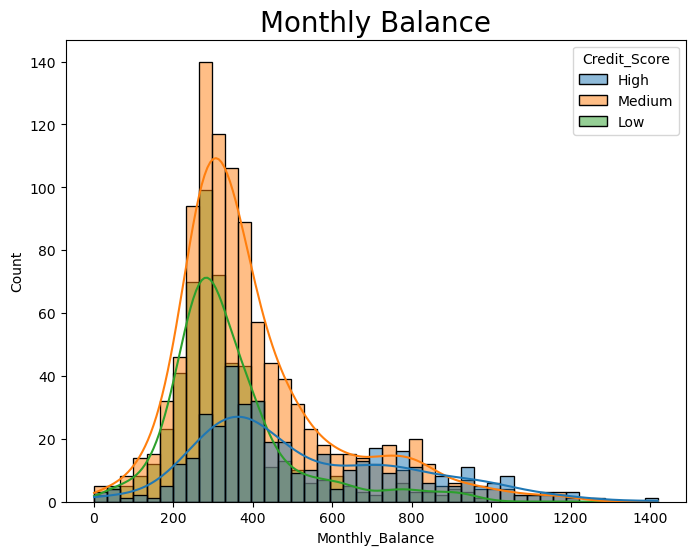

In [51]:
plt.figure(figsize=(8,6))
sns.histplot(data=df, x="Monthly_Balance", kde = True, hue="Credit_Score")
plt.title("Monthly Balance", fontsize=20)
plt.show()

<Figure size 1000x600 with 0 Axes>

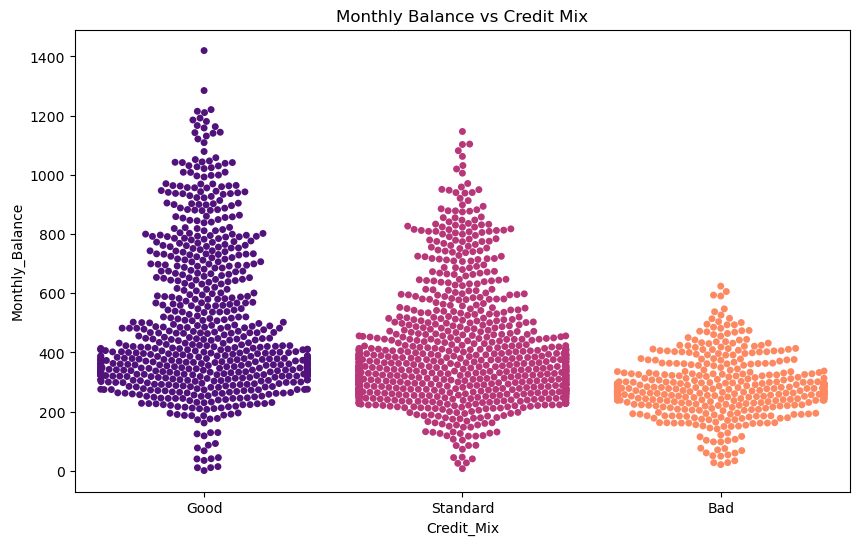

In [52]:
#Monthly Balance vs Credit Mix
plt.figure(figsize=(10, 6))
plt.figure(figsize=(10, 6))
sns.swarmplot(x=df["Credit_Mix"], y=df["Monthly_Balance"], palette="magma")
plt.title("Monthly Balance vs Credit Mix")
plt.show()

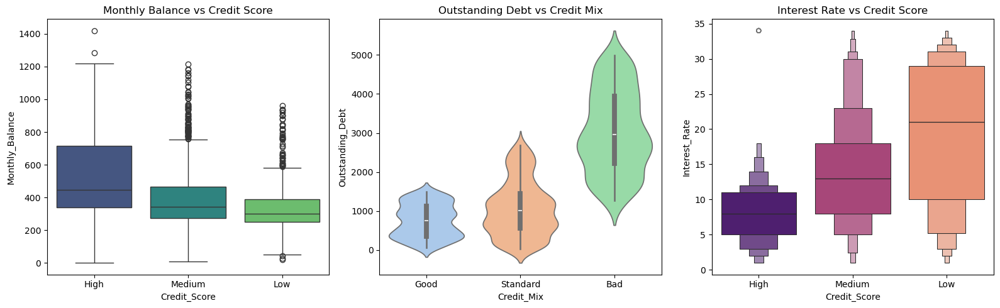

In [53]:

plt.figure(figsize=(16, 5))

# Box Plot: Credit Score vs Monthly Balance
plt.subplot(1, 3, 1)
sns.boxplot(x="Credit_Score", y="Monthly_Balance", data=df, palette="viridis")
plt.title("Monthly Balance vs Credit Score")

# Credit Mix vs Outstanding Debt
plt.subplot(1, 3, 2)
sns.violinplot(x="Credit_Mix", y="Outstanding_Debt", data=df, palette="pastel")
plt.title("Outstanding Debt vs Credit Mix")

#  Credit Score vs Interest Rate
plt.subplot(1, 3, 3)
sns.boxenplot(x="Credit_Score", y="Interest_Rate", data=df, palette="magma")
plt.title("Interest Rate vs Credit Score")

plt.tight_layout()

plt.show()


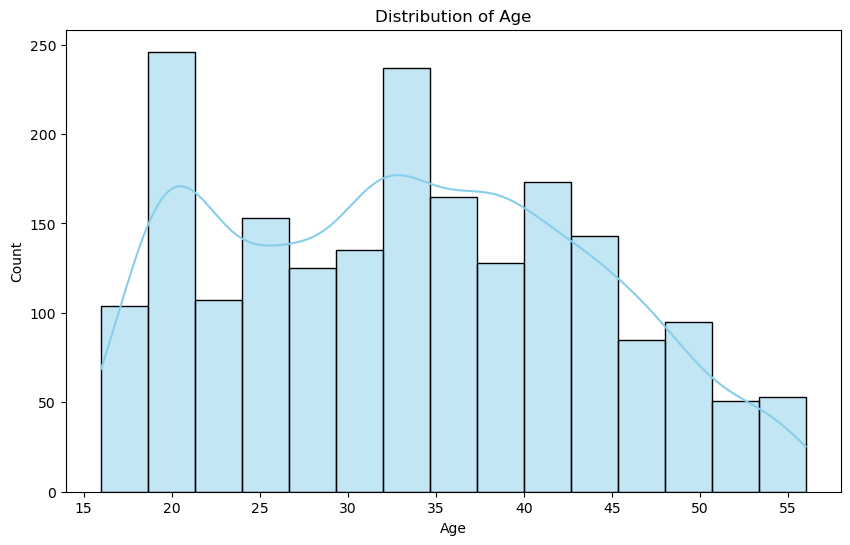

In [54]:
#Distribution of Age
plt.figure(figsize=(10, 6))
sns.histplot(df['Age'], bins=15, kde=True, color='skyblue')
plt.title('Distribution of Age')
plt.show()

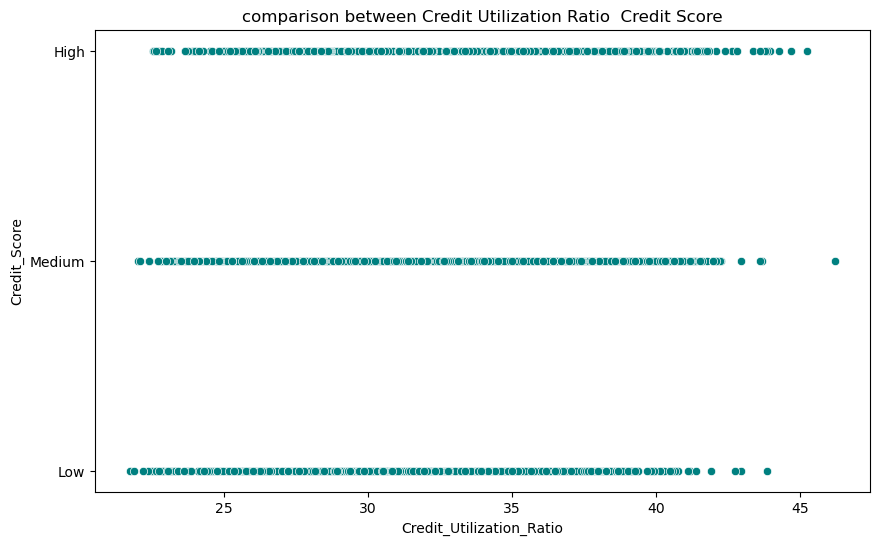

In [55]:
#Credit Utilization Ratio vs Credit Score
plt.figure(figsize=(10, 6))
sns.scatterplot(x='Credit_Utilization_Ratio', y='Credit_Score', data=df, color='teal')
plt.title('comparison between Credit Utilization Ratio  Credit Score')
plt.show()

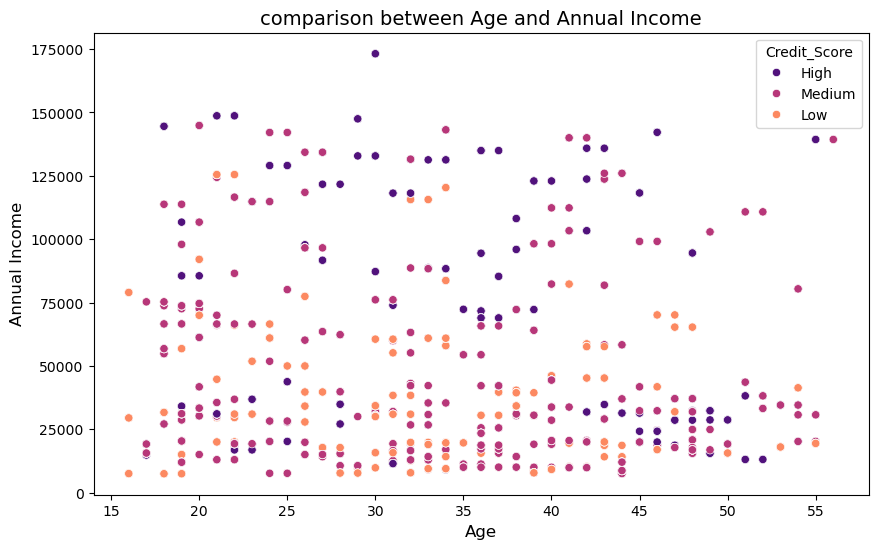

In [56]:
# Scatter plot between 'Age' and 'Annual_Income'
plt.figure(figsize=(10, 6))
sns.scatterplot(x=df["Age"], y=df["Annual_Income"], hue=df["Credit_Score"], palette="magma")
plt.xlabel("Age", fontsize=12)
plt.ylabel("Annual Income", fontsize=12)
plt.title("comparison between Age and Annual Income", fontsize=14)
plt.show()

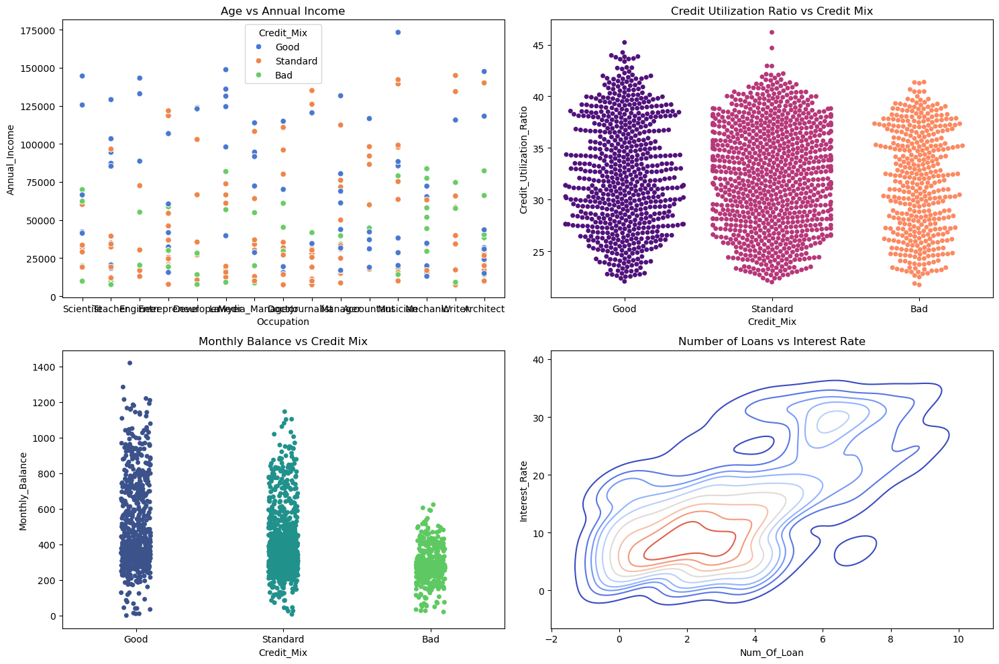

In [57]:
fig, axes = plt.subplots(2, 2, figsize=(15, 10))
axes = axes.flatten()

# Age vs Annual Income
sns.scatterplot(x=df["Occupation"], y=df["Annual_Income"], hue=df["Credit_Mix"], ax=axes[0], palette="muted")
axes[0].set_title("Age vs Annual Income")

#  Credit Utilization Ratio vs Credit Mix
sns.swarmplot(x=df["Credit_Mix"], y=df["Credit_Utilization_Ratio"], ax=axes[1], palette="magma")
axes[1].set_title("Credit Utilization Ratio vs Credit Mix")

#  Monthly Balance vs Credit Mix
sns.stripplot(x=df["Credit_Mix"], y=df["Monthly_Balance"], ax=axes[2], palette="viridis")
axes[2].set_title("Monthly Balance vs Credit Mix")

#  Number of Loans vs Interest Rate
sns.kdeplot(x=df["Num_Of_Loan"], y=df["Interest_Rate"], ax=axes[3], cmap="coolwarm")
axes[3].set_title("Number of Loans vs Interest Rate")


plt.tight_layout()
plt.show()


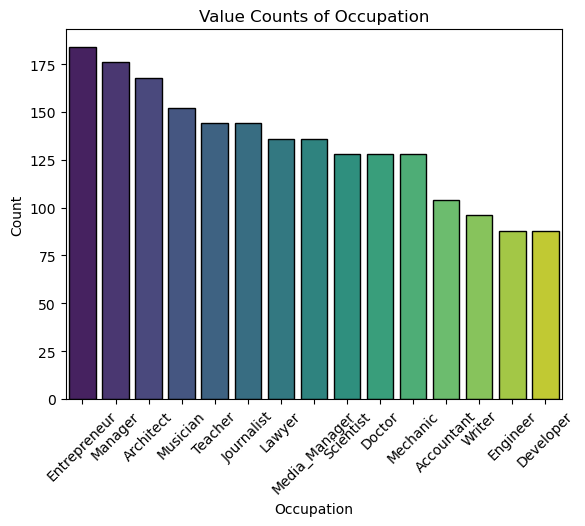

In [58]:
Occupation_count = df['Occupation'].value_counts()

sns.barplot(x=Occupation_count.index, y=Occupation_count.values,palette="viridis", edgecolor="black")

plt.xlabel('Occupation')
plt.ylabel('Count')
plt.title('Value Counts of Occupation')

plt.xticks(rotation=45)

plt.show()

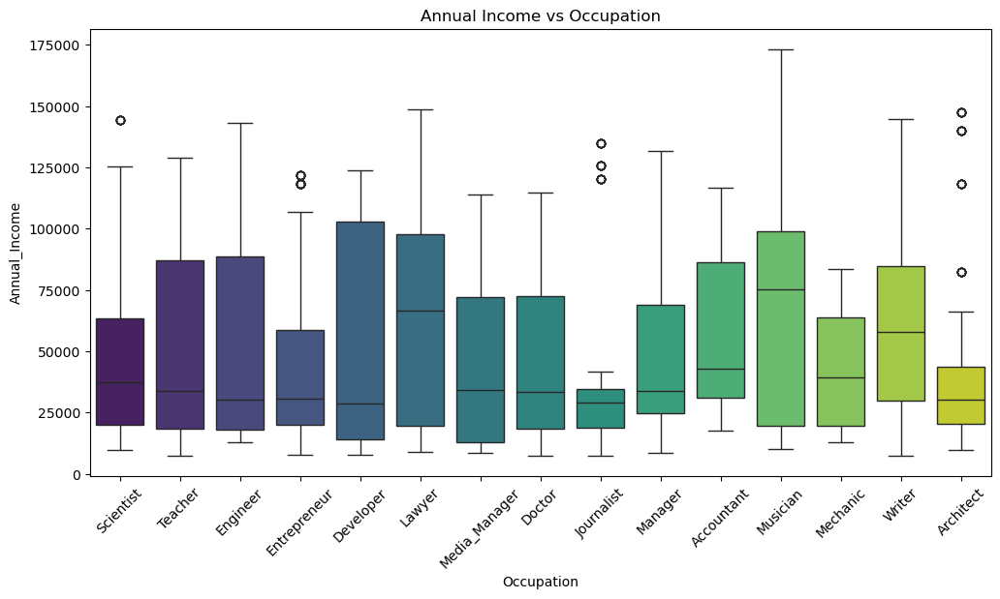

In [59]:
#Annual Income vs Occupation
plt.figure(figsize=(12, 6))
sns.boxplot(x=df["Occupation"], y=df["Annual_Income"], palette="viridis")
plt.xticks(rotation=45)  # Rotate labels for readability
plt.title("Annual Income vs Occupation")
plt.show()

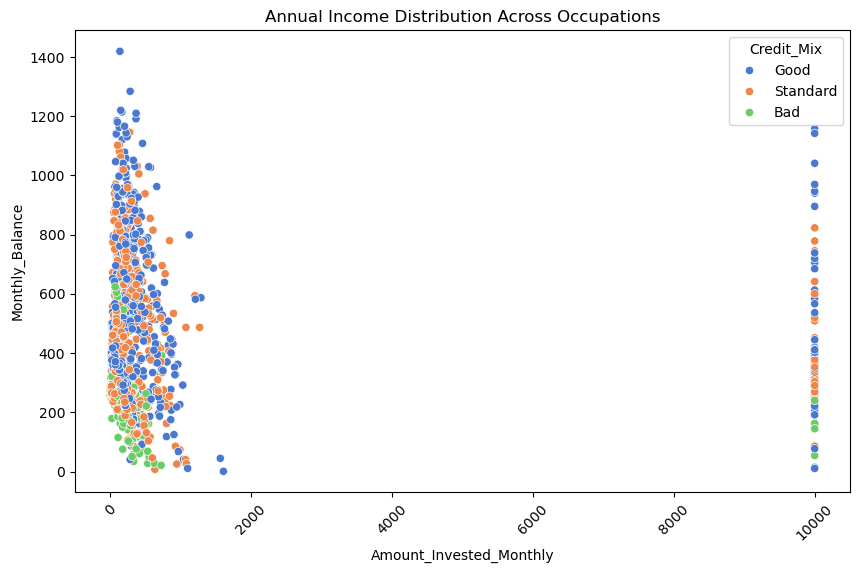

In [60]:
# Annual Income Distribution Across Occupations
plt.figure(figsize=(10, 6))
sns.scatterplot(x=df["Amount_Invested_Monthly"], y=df["Monthly_Balance"],hue=df["Credit_Mix"],palette="muted")
plt.xticks(rotation=45)
plt.title("Annual Income Distribution Across Occupations")
plt.show()

#### CHECK AND HANDLING OUTLIERS

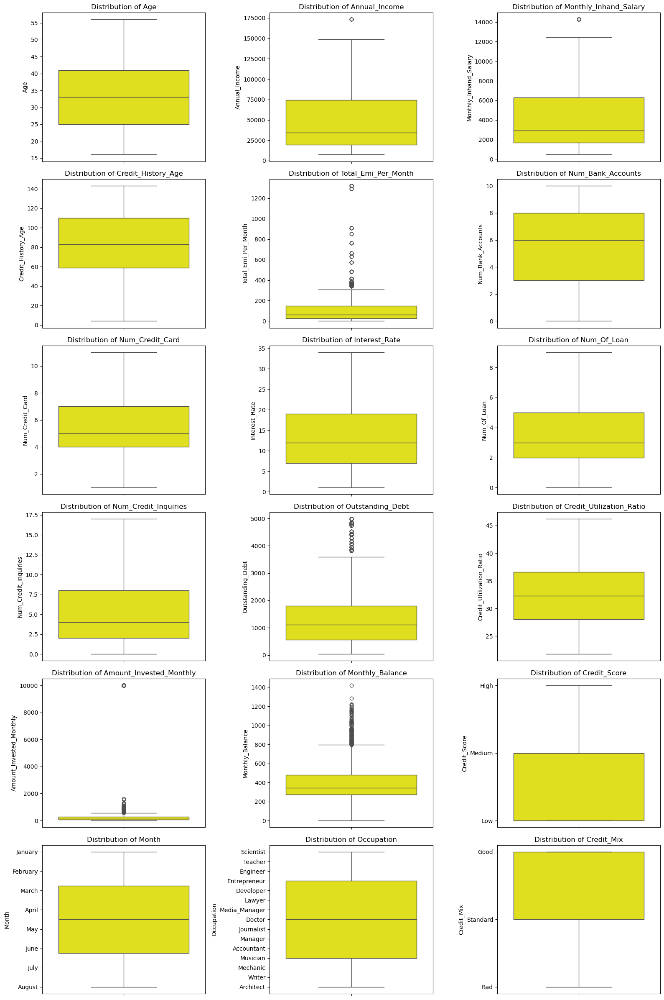

In [61]:
cols=['Age','Annual_Income','Monthly_Inhand_Salary', 'Credit_History_Age', 'Total_Emi_Per_Month','Num_Bank_Accounts', 
               'Num_Credit_Card', 'Interest_Rate', 'Num_Of_Loan', 'Num_Credit_Inquiries','Outstanding_Debt', 
               'Credit_Utilization_Ratio','Amount_Invested_Monthly', 'Monthly_Balance','Credit_Score','Month','Occupation','Credit_Mix']
fig, axes = plt.subplots(6,3,figsize=(16,24))
axes = axes.flatten()
for i, col in enumerate(cols):
    sns.boxplot(df[col], ax=axes[i],color="yellow")
    axes[i].set_title(f"Distribution of {col}")
plt.tight_layout()
plt.show()

In [62]:
def Handling_OF_Outliers(col):
    print(f"{col} : Outliers Checking") 
    sns.boxplot(df[col], color = "orange")
    plt.show()

    q1 = df[col].quantile(0.25)
    q3 = df[col].quantile(0.75)

    iqr  = q3 - q1
    print(f"IQR = {iqr}")

    LowerTail = q1 - 1.5 * iqr
    UpperTail = q3 + 1.5 * iqr

    print(f"Lower Tail = {LowerTail}")
    print(f"Upper Tail = {UpperTail}")
    print("-"*80)

    # Detecting for outliers
    Outliers = df[(df[col] < LowerTail) | (df[col] > UpperTail)]
    print(f"\nOutliers of {col} :\n{Outliers}")

    # Handling of outliers
    df.loc[(df[col] < LowerTail), col] = LowerTail
    df.loc[(df[col] > UpperTail), col] = UpperTail

    print("Dataframe After Handling of outliers:\n")
    print(df.head())

Monthly_Inhand_Salary : Outliers Checking


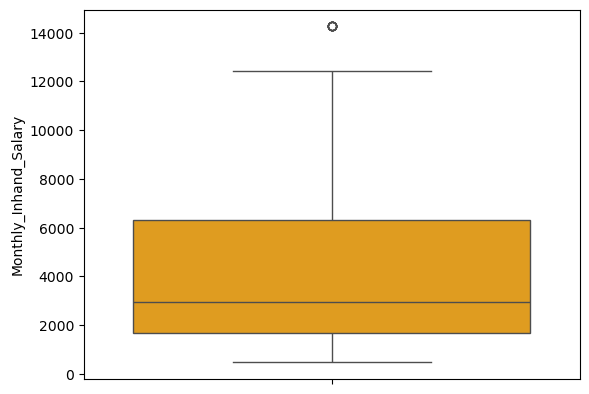

IQR = 4615.7495
Lower Tail = -5238.7922499999995
Upper Tail = 13224.205750000001
--------------------------------------------------------------------------------

Outliers of Monthly_Inhand_Salary :
         Month   Name  Age Occupation  Annual_Income  Monthly_Inhand_Salary  \
1672   January  Yokog   30   Musician      173196.31              14258.026   
1673  February  Yokog   30   Musician      173196.31              14258.026   
1674     March  Yokog   30   Musician      173196.31              14258.026   
1675     April  Yokog   30   Musician      173196.31              14258.026   
1676       May  Yokog   30   Musician      173196.31              14258.026   
1677      June  Yokog   30   Musician      173196.31              14258.026   
1678      July  Yokog   30   Musician      173196.31              14258.026   
1679    August  Yokog   30   Musician      173196.31              14258.026   

      Credit_History_Age  Total_Emi_Per_Month  Num_Bank_Accounts  \
1672                 

In [63]:
Handling_OF_Outliers("Monthly_Inhand_Salary")

Total_Emi_Per_Month : Outliers Checking


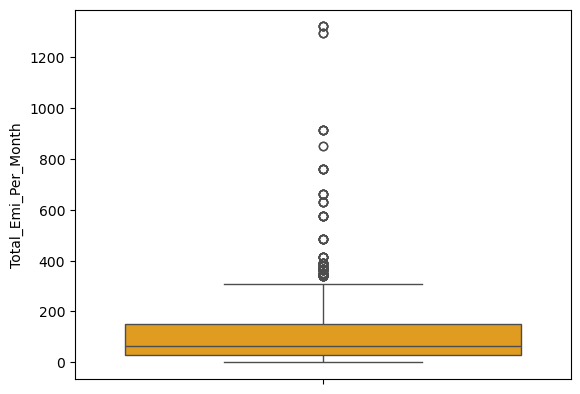

IQR = 122.374377
Lower Tail = -156.0387425
Upper Tail = 333.4587655
--------------------------------------------------------------------------------

Outliers of Total_Emi_Per_Month :
       Month                    Name  Age Occupation  Annual_Income  \
50     March                  Nadiaq   34     Lawyer      131313.40   
51     April                  Nadiaq   34     Lawyer      131313.40   
52       May                  Nadiaq   34     Lawyer      131313.40   
53      June                  Nadiaq   34     Lawyer      131313.40   
54      July                  Nadiaq   34     Lawyer      131313.40   
...      ...                     ...  ...        ...            ...   
1899   April  Caroline Valetkevitchr   31  Architect      118172.64   
1900     May  Caroline Valetkevitchr   31  Architect      118172.64   
1901    June  Caroline Valetkevitchr   32  Architect      118172.64   
1902    July  Caroline Valetkevitchr   32  Architect      118172.64   
1903  August  Caroline Valetkevitch

In [64]:
Handling_OF_Outliers("Total_Emi_Per_Month")

Num_Credit_Card : Outliers Checking


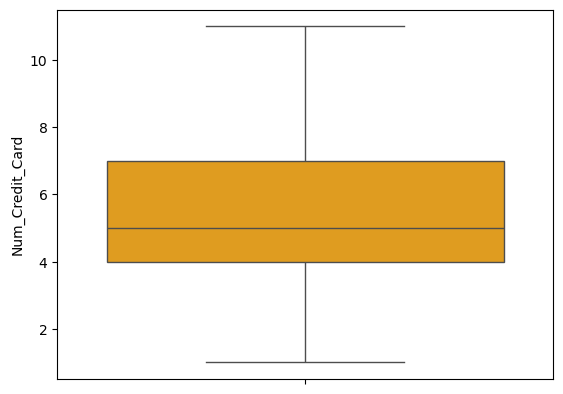

IQR = 3.0
Lower Tail = -0.5
Upper Tail = 11.5
--------------------------------------------------------------------------------

Outliers of Num_Credit_Card :
Empty DataFrame
Columns: [Month, Name, Age, Occupation, Annual_Income, Monthly_Inhand_Salary, Credit_History_Age, Total_Emi_Per_Month, Num_Bank_Accounts, Num_Credit_Card, Interest_Rate, Num_Of_Loan, Type_Of_Loan, Num_Credit_Inquiries, Credit_Mix, Outstanding_Debt, Credit_Utilization_Ratio, Amount_Invested_Monthly, Payment_Behaviour, Monthly_Balance, Credit_Score]
Index: []

[0 rows x 21 columns]
Dataframe After Handling of outliers:

      Month           Name  Age Occupation  Annual_Income  \
0   January  Aaron Maashoh   23  Scientist       19114.12   
1  February  Aaron Maashoh   23  Scientist       19114.12   
2     March  Aaron Maashoh   23  Scientist       19114.12   
3     April  Aaron Maashoh   23  Scientist       19114.12   
4       May  Aaron Maashoh   23  Scientist       19114.12   

   Monthly_Inhand_Salary  Credit_Hist

In [65]:
Handling_OF_Outliers("Num_Credit_Card")

Num_Of_Loan : Outliers Checking


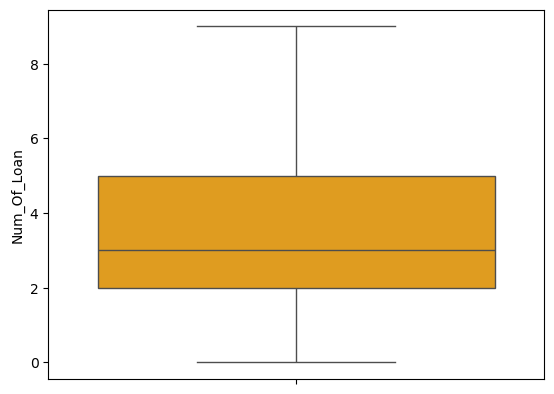

IQR = 3.0
Lower Tail = -2.5
Upper Tail = 9.5
--------------------------------------------------------------------------------

Outliers of Num_Of_Loan :
Empty DataFrame
Columns: [Month, Name, Age, Occupation, Annual_Income, Monthly_Inhand_Salary, Credit_History_Age, Total_Emi_Per_Month, Num_Bank_Accounts, Num_Credit_Card, Interest_Rate, Num_Of_Loan, Type_Of_Loan, Num_Credit_Inquiries, Credit_Mix, Outstanding_Debt, Credit_Utilization_Ratio, Amount_Invested_Monthly, Payment_Behaviour, Monthly_Balance, Credit_Score]
Index: []

[0 rows x 21 columns]
Dataframe After Handling of outliers:

      Month           Name  Age Occupation  Annual_Income  \
0   January  Aaron Maashoh   23  Scientist       19114.12   
1  February  Aaron Maashoh   23  Scientist       19114.12   
2     March  Aaron Maashoh   23  Scientist       19114.12   
3     April  Aaron Maashoh   23  Scientist       19114.12   
4       May  Aaron Maashoh   23  Scientist       19114.12   

   Monthly_Inhand_Salary  Credit_History_A

In [66]:
Handling_OF_Outliers("Num_Of_Loan")

Num_Credit_Inquiries : Outliers Checking


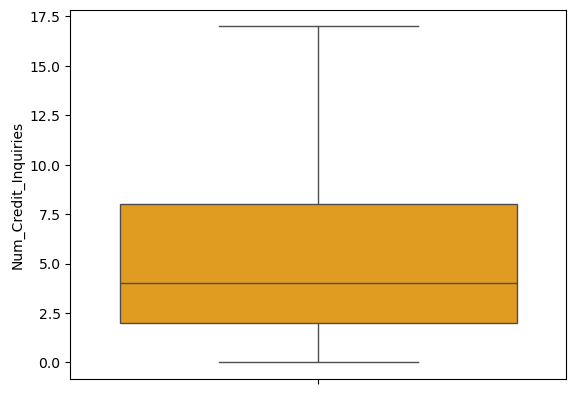

IQR = 6.0
Lower Tail = -7.0
Upper Tail = 17.0
--------------------------------------------------------------------------------

Outliers of Num_Credit_Inquiries :
Empty DataFrame
Columns: [Month, Name, Age, Occupation, Annual_Income, Monthly_Inhand_Salary, Credit_History_Age, Total_Emi_Per_Month, Num_Bank_Accounts, Num_Credit_Card, Interest_Rate, Num_Of_Loan, Type_Of_Loan, Num_Credit_Inquiries, Credit_Mix, Outstanding_Debt, Credit_Utilization_Ratio, Amount_Invested_Monthly, Payment_Behaviour, Monthly_Balance, Credit_Score]
Index: []

[0 rows x 21 columns]
Dataframe After Handling of outliers:

      Month           Name  Age Occupation  Annual_Income  \
0   January  Aaron Maashoh   23  Scientist       19114.12   
1  February  Aaron Maashoh   23  Scientist       19114.12   
2     March  Aaron Maashoh   23  Scientist       19114.12   
3     April  Aaron Maashoh   23  Scientist       19114.12   
4       May  Aaron Maashoh   23  Scientist       19114.12   

   Monthly_Inhand_Salary  Credit

In [67]:
Handling_OF_Outliers("Num_Credit_Inquiries")

Outstanding_Debt : Outliers Checking


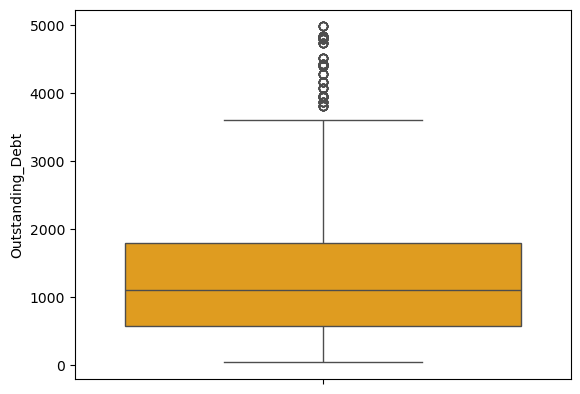

IQR = 1228.32
Lower Tail = -1277.26
Upper Tail = 3636.02
--------------------------------------------------------------------------------

Outliers of Outstanding_Debt :
         Month          Name  Age Occupation  Annual_Income  \
400    January     Kazunorit   43  Developer       14129.76   
401   February     Kazunorit   44  Developer       14129.76   
402      March     Kazunorit   44  Developer       14129.76   
403      April     Kazunorit   44  Developer       14129.76   
404        May     Kazunorit   44  Developer       14129.76   
...        ...           ...  ...        ...            ...   
1803     April  Sarah Whited   40  Architect       82289.36   
1804       May  Sarah Whited   41  Architect       82289.36   
1805      June  Sarah Whited   41  Architect       82289.36   
1806      July  Sarah Whited   41  Architect       82289.36   
1807    August  Sarah Whited   41  Architect       82289.36   

      Monthly_Inhand_Salary  Credit_History_Age  Total_Emi_Per_Month  \
4

In [68]:
Handling_OF_Outliers("Outstanding_Debt")

Credit_Utilization_Ratio : Outliers Checking


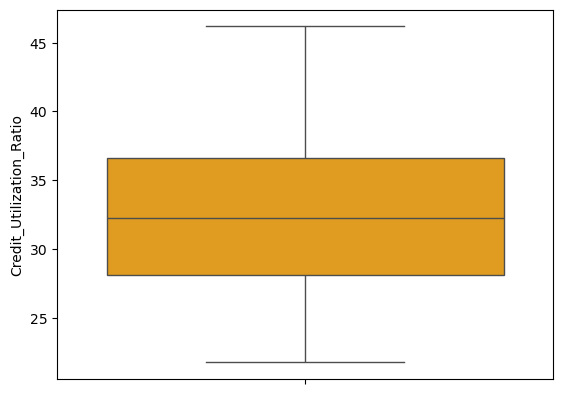

IQR = 8.512975
Lower Tail = 15.309342249999998
Upper Tail = 49.361242250000004
--------------------------------------------------------------------------------

Outliers of Credit_Utilization_Ratio :
Empty DataFrame
Columns: [Month, Name, Age, Occupation, Annual_Income, Monthly_Inhand_Salary, Credit_History_Age, Total_Emi_Per_Month, Num_Bank_Accounts, Num_Credit_Card, Interest_Rate, Num_Of_Loan, Type_Of_Loan, Num_Credit_Inquiries, Credit_Mix, Outstanding_Debt, Credit_Utilization_Ratio, Amount_Invested_Monthly, Payment_Behaviour, Monthly_Balance, Credit_Score]
Index: []

[0 rows x 21 columns]
Dataframe After Handling of outliers:

      Month           Name  Age Occupation  Annual_Income  \
0   January  Aaron Maashoh   23  Scientist       19114.12   
1  February  Aaron Maashoh   23  Scientist       19114.12   
2     March  Aaron Maashoh   23  Scientist       19114.12   
3     April  Aaron Maashoh   23  Scientist       19114.12   
4       May  Aaron Maashoh   23  Scientist       19114.12

In [69]:
Handling_OF_Outliers("Credit_Utilization_Ratio")

Amount_Invested_Monthly : Outliers Checking


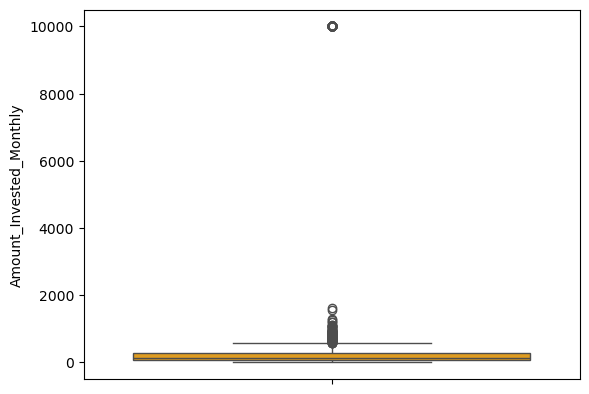

IQR = 200.5633325
Lower Tail = -226.83567125000002
Upper Tail = 575.41765875
--------------------------------------------------------------------------------

Outliers of Amount_Invested_Monthly :
         Month              Name  Age    Occupation  Annual_Income  \
18       March            Langep   34      Engineer     143162.640   
19       April            Langep   34      Engineer     143162.640   
23      August            Langep   34      Engineer     143162.640   
28         May            Jasond   55  Entrepreneur      30689.890   
43       April                Np   31        Lawyer      73928.460   
...        ...               ...  ...           ...            ...   
1980       May  Anna Yukhananovm   16        Doctor       7495.305   
1983    August  Anna Yukhananovm   16        Doctor       7495.305   
1988       May             Annab   48      Mechanic      16866.500   
1993  February            Alpere   33    Accountant      18969.190   
1994     March            Alpere 

In [70]:
Handling_OF_Outliers("Amount_Invested_Monthly")

Monthly_Balance : Outliers Checking


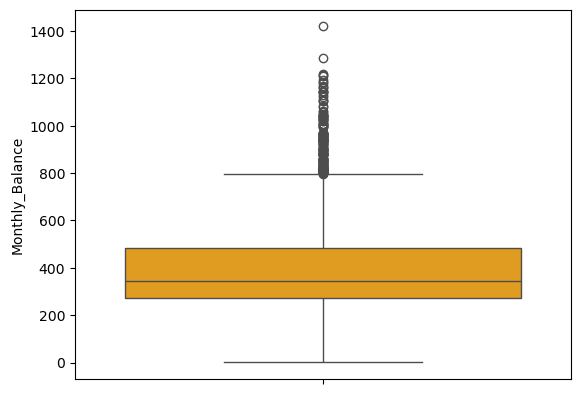

IQR = 209.07339750000006
Lower Tail = -40.690081250000105
Upper Tail = 795.6035087500002
--------------------------------------------------------------------------------

Outliers of Monthly_Balance :
         Month                Name  Age    Occupation  Annual_Income  \
16     January              Langep   34      Engineer      143162.64   
17    February              Langep   34      Engineer      143162.64   
20         May              Langep   34      Engineer      143162.64   
21        June              Langep   34      Engineer      143162.64   
22        July              Langep   34      Engineer      143162.64   
...        ...                 ...  ...           ...            ...   
1877      June           Sullivang   40    Accountant       98197.74   
1928   January  Norihiko Shirouzun   27  Entrepreneur      121688.04   
1930     March  Norihiko Shirouzun   27  Entrepreneur      121688.04   
1932       May  Norihiko Shirouzun   27  Entrepreneur      121688.04   
1970   

In [71]:
Handling_OF_Outliers("Monthly_Balance")

### HYPOTHESIS TESTING

In [72]:
stats,p_val=shapiro(df["Age"])
print("p_val:",p_val)
if p_val>=0.05:
    print("Null Hypothesis(H0) is True")
    print("Age ColumnS data is normally Distributed")
else:
    print("alternatative Hypothesis (H1) is True")
    print("Age ColumnS data is not normally Distributed")

p_val: 9.825310160508195e-21
alternatative Hypothesis (H1) is True
Age ColumnS data is not normally Distributed


In [73]:
stat, p_val = shapiro(df["Interest_Rate"])

print("p-value:", p_val)
if p_val >= 0.05:
    print("Data is normally distributed in column 'Interest_Rate'.")
else:
    print("Data is not normally distributed in column 'Interest_Rate'.")

p-value: 3.5620158816860476e-29
Data is not normally distributed in column 'Interest_Rate'.


In [74]:
stat, p_value = normaltest(df['Annual_Income'])
print("D'Agostino and Pearson's Test p-value:", p_value)
if p_value >= 0.05:
    print("Data is normally distributed.")
else:
    print("Data is not normally distributed.")

D'Agostino and Pearson's Test p-value: 6.279751191331306e-51
Data is not normally distributed.


In [75]:
# Chi-Square Test 

contingency_table = pd.crosstab(df['Num_Credit_Card'], df['Num_Of_Loan'])
chi2_stat, p_value, dof, expected = chi2_contingency(contingency_table)

print(f"Chi-Square Test: p-value = {p_value}")
if p_value < 0.05:
    print("Reject the null hypothesis: There is an association between 'Num_Credit_Card' and 'Num_Of_Loan'.")
else:
    print("Fail to reject the null hypothesis: No significant association between 'Num_Credit_Card' and 'Num_Of_Loan'.")


Chi-Square Test: p-value = 1.189206406083787e-210
Reject the null hypothesis: There is an association between 'Num_Credit_Card' and 'Num_Of_Loan'.


#### Z-Score

In [76]:
df["zscore"]=scipy.stats.zscore(df["Interest_Rate"])

In [77]:
df

,Month,Name,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Credit_History_Age,Total_Emi_Per_Month,Num_Bank_Accounts,Num_Credit_Card,...,Type_Of_Loan,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Amount_Invested_Monthly,Payment_Behaviour,Monthly_Balance,Credit_Score,zscore
0,January,Aaron Maashoh,23,Scientist,19114.12,1824.8434,89,49.574947,3,4.0,...,"['Auto Loan', 'Credit-Builder Loan', 'Personal...",4,Good,809.98,26.822620,80.415300,High_spent_Small_value_payments,312.49408,High,-1.248843
1,February,Aaron Maashoh,23,Scientist,19114.12,1824.8434,93,49.574947,3,4.0,...,"['Auto Loan', 'Credit-Builder Loan', 'Personal...",4,Good,809.98,31.944960,118.280220,Low_spent_Large_value_payments,284.62915,High,-1.248843
2,March,Aaron Maashoh,23,Scientist,19114.12,1824.8434,91,49.574947,3,4.0,...,"['Auto Loan', 'Credit-Builder Loan', 'Personal...",4,Good,809.98,28.609352,81.699524,Low_spent_Medium_value_payments,331.20987,High,-1.248843
3,April,Aaron Maashoh,23,Scientist,19114.12,1824.8434,92,49.574947,3,4.0,...,"['Auto Loan', 'Credit-Builder Loan', 'Personal...",4,Good,809.98,31.377861,199.458070,Low_spent_Small_value_payments,223.45131,High,-1.248843
4,May,Aaron Maashoh,23,Scientist,19114.12,1824.8434,93,49.574947,3,4.0,...,"['Auto Loan', 'Credit-Builder Loan', 'Personal...",4,Good,809.98,24.797346,41.420155,High_spent_Medium_value_payments,341.48923,High,-1.248843
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,April,Alpere,33,Accountant,18969.19,1849.7659,96,0.000000,1,7.0,...,['No Loan'],2,Good,54.82,25.290200,131.781600,Low_spent_Small_value_payments,343.19498,Low,-0.686909
1996,May,Alpere,33,Accountant,18969.19,1849.7659,100,0.000000,1,7.0,...,['No Loan'],2,Good,54.82,25.162382,117.216770,Low_spent_Small_value_payments,357.75983,Low,-0.686909
1997,June,Alpere,33,Accountant,18969.19,1849.7659,98,0.000000,1,7.0,...,['No Loan'],2,Good,54.82,27.207150,74.645200,High_spent_Medium_value_payments,360.33140,Low,-0.686909
1998,July,Alpere,33,Accountant,18969.19,1849.7659,99,0.000000,1,7.0,...,['No Loan'],2,Good,54.82,37.389046,182.977800,Low_spent_Small_value_payments,291.99878,Medium,-0.686909


#### CONVERTING DATATYPE TO OBJECT TO NUMERICAL

In [78]:
le=LabelEncoder()
le_array=le.fit_transform(df["Month"])
df["Month"]=pd.DataFrame(le_array)
df

,Month,Name,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Credit_History_Age,Total_Emi_Per_Month,Num_Bank_Accounts,Num_Credit_Card,...,Type_Of_Loan,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Amount_Invested_Monthly,Payment_Behaviour,Monthly_Balance,Credit_Score,zscore
0,3,Aaron Maashoh,23,Scientist,19114.12,1824.8434,89,49.574947,3,4.0,...,"['Auto Loan', 'Credit-Builder Loan', 'Personal...",4,Good,809.98,26.822620,80.415300,High_spent_Small_value_payments,312.49408,High,-1.248843
1,2,Aaron Maashoh,23,Scientist,19114.12,1824.8434,93,49.574947,3,4.0,...,"['Auto Loan', 'Credit-Builder Loan', 'Personal...",4,Good,809.98,31.944960,118.280220,Low_spent_Large_value_payments,284.62915,High,-1.248843
2,6,Aaron Maashoh,23,Scientist,19114.12,1824.8434,91,49.574947,3,4.0,...,"['Auto Loan', 'Credit-Builder Loan', 'Personal...",4,Good,809.98,28.609352,81.699524,Low_spent_Medium_value_payments,331.20987,High,-1.248843
3,0,Aaron Maashoh,23,Scientist,19114.12,1824.8434,92,49.574947,3,4.0,...,"['Auto Loan', 'Credit-Builder Loan', 'Personal...",4,Good,809.98,31.377861,199.458070,Low_spent_Small_value_payments,223.45131,High,-1.248843
4,7,Aaron Maashoh,23,Scientist,19114.12,1824.8434,93,49.574947,3,4.0,...,"['Auto Loan', 'Credit-Builder Loan', 'Personal...",4,Good,809.98,24.797346,41.420155,High_spent_Medium_value_payments,341.48923,High,-1.248843
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,0,Alpere,33,Accountant,18969.19,1849.7659,96,0.000000,1,7.0,...,['No Loan'],2,Good,54.82,25.290200,131.781600,Low_spent_Small_value_payments,343.19498,Low,-0.686909
1996,7,Alpere,33,Accountant,18969.19,1849.7659,100,0.000000,1,7.0,...,['No Loan'],2,Good,54.82,25.162382,117.216770,Low_spent_Small_value_payments,357.75983,Low,-0.686909
1997,5,Alpere,33,Accountant,18969.19,1849.7659,98,0.000000,1,7.0,...,['No Loan'],2,Good,54.82,27.207150,74.645200,High_spent_Medium_value_payments,360.33140,Low,-0.686909
1998,4,Alpere,33,Accountant,18969.19,1849.7659,99,0.000000,1,7.0,...,['No Loan'],2,Good,54.82,37.389046,182.977800,Low_spent_Small_value_payments,291.99878,Medium,-0.686909


In [79]:
le=LabelEncoder()
le_array=le.fit_transform(df["Name"])
df["Name"]=pd.DataFrame(le_array)
df

,Month,Name,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Credit_History_Age,Total_Emi_Per_Month,Num_Bank_Accounts,Num_Credit_Card,...,Type_Of_Loan,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Amount_Invested_Monthly,Payment_Behaviour,Monthly_Balance,Credit_Score,zscore
0,3,4,23,Scientist,19114.12,1824.8434,89,49.574947,3,4.0,...,"['Auto Loan', 'Credit-Builder Loan', 'Personal...",4,Good,809.98,26.822620,80.415300,High_spent_Small_value_payments,312.49408,High,-1.248843
1,2,4,23,Scientist,19114.12,1824.8434,93,49.574947,3,4.0,...,"['Auto Loan', 'Credit-Builder Loan', 'Personal...",4,Good,809.98,31.944960,118.280220,Low_spent_Large_value_payments,284.62915,High,-1.248843
2,6,4,23,Scientist,19114.12,1824.8434,91,49.574947,3,4.0,...,"['Auto Loan', 'Credit-Builder Loan', 'Personal...",4,Good,809.98,28.609352,81.699524,Low_spent_Medium_value_payments,331.20987,High,-1.248843
3,0,4,23,Scientist,19114.12,1824.8434,92,49.574947,3,4.0,...,"['Auto Loan', 'Credit-Builder Loan', 'Personal...",4,Good,809.98,31.377861,199.458070,Low_spent_Small_value_payments,223.45131,High,-1.248843
4,7,4,23,Scientist,19114.12,1824.8434,93,49.574947,3,4.0,...,"['Auto Loan', 'Credit-Builder Loan', 'Personal...",4,Good,809.98,24.797346,41.420155,High_spent_Medium_value_payments,341.48923,High,-1.248843
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,0,15,33,Accountant,18969.19,1849.7659,96,0.000000,1,7.0,...,['No Loan'],2,Good,54.82,25.290200,131.781600,Low_spent_Small_value_payments,343.19498,Low,-0.686909
1996,7,15,33,Accountant,18969.19,1849.7659,100,0.000000,1,7.0,...,['No Loan'],2,Good,54.82,25.162382,117.216770,Low_spent_Small_value_payments,357.75983,Low,-0.686909
1997,5,15,33,Accountant,18969.19,1849.7659,98,0.000000,1,7.0,...,['No Loan'],2,Good,54.82,27.207150,74.645200,High_spent_Medium_value_payments,360.33140,Low,-0.686909
1998,4,15,33,Accountant,18969.19,1849.7659,99,0.000000,1,7.0,...,['No Loan'],2,Good,54.82,37.389046,182.977800,Low_spent_Small_value_payments,291.99878,Medium,-0.686909


In [80]:
le=LabelEncoder()
le_array=le.fit_transform(df["Occupation"])
df["Occupation"]=pd.DataFrame(le_array)
df

,Month,Name,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Credit_History_Age,Total_Emi_Per_Month,Num_Bank_Accounts,Num_Credit_Card,...,Type_Of_Loan,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Amount_Invested_Monthly,Payment_Behaviour,Monthly_Balance,Credit_Score,zscore
0,3,4,23,12,19114.12,1824.8434,89,49.574947,3,4.0,...,"['Auto Loan', 'Credit-Builder Loan', 'Personal...",4,Good,809.98,26.822620,80.415300,High_spent_Small_value_payments,312.49408,High,-1.248843
1,2,4,23,12,19114.12,1824.8434,93,49.574947,3,4.0,...,"['Auto Loan', 'Credit-Builder Loan', 'Personal...",4,Good,809.98,31.944960,118.280220,Low_spent_Large_value_payments,284.62915,High,-1.248843
2,6,4,23,12,19114.12,1824.8434,91,49.574947,3,4.0,...,"['Auto Loan', 'Credit-Builder Loan', 'Personal...",4,Good,809.98,28.609352,81.699524,Low_spent_Medium_value_payments,331.20987,High,-1.248843
3,0,4,23,12,19114.12,1824.8434,92,49.574947,3,4.0,...,"['Auto Loan', 'Credit-Builder Loan', 'Personal...",4,Good,809.98,31.377861,199.458070,Low_spent_Small_value_payments,223.45131,High,-1.248843
4,7,4,23,12,19114.12,1824.8434,93,49.574947,3,4.0,...,"['Auto Loan', 'Credit-Builder Loan', 'Personal...",4,Good,809.98,24.797346,41.420155,High_spent_Medium_value_payments,341.48923,High,-1.248843
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,0,15,33,0,18969.19,1849.7659,96,0.000000,1,7.0,...,['No Loan'],2,Good,54.82,25.290200,131.781600,Low_spent_Small_value_payments,343.19498,Low,-0.686909
1996,7,15,33,0,18969.19,1849.7659,100,0.000000,1,7.0,...,['No Loan'],2,Good,54.82,25.162382,117.216770,Low_spent_Small_value_payments,357.75983,Low,-0.686909
1997,5,15,33,0,18969.19,1849.7659,98,0.000000,1,7.0,...,['No Loan'],2,Good,54.82,27.207150,74.645200,High_spent_Medium_value_payments,360.33140,Low,-0.686909
1998,4,15,33,0,18969.19,1849.7659,99,0.000000,1,7.0,...,['No Loan'],2,Good,54.82,37.389046,182.977800,Low_spent_Small_value_payments,291.99878,Medium,-0.686909


In [81]:
le=LabelEncoder()
le_array=le.fit_transform(df["Type_Of_Loan"])
df["Type_Of_Loan"]=pd.DataFrame(le_array)
df

,Month,Name,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Credit_History_Age,Total_Emi_Per_Month,Num_Bank_Accounts,Num_Credit_Card,...,Type_Of_Loan,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Amount_Invested_Monthly,Payment_Behaviour,Monthly_Balance,Credit_Score,zscore
0,3,4,23,12,19114.12,1824.8434,89,49.574947,3,4.0,...,7,4,Good,809.98,26.822620,80.415300,High_spent_Small_value_payments,312.49408,High,-1.248843
1,2,4,23,12,19114.12,1824.8434,93,49.574947,3,4.0,...,7,4,Good,809.98,31.944960,118.280220,Low_spent_Large_value_payments,284.62915,High,-1.248843
2,6,4,23,12,19114.12,1824.8434,91,49.574947,3,4.0,...,7,4,Good,809.98,28.609352,81.699524,Low_spent_Medium_value_payments,331.20987,High,-1.248843
3,0,4,23,12,19114.12,1824.8434,92,49.574947,3,4.0,...,7,4,Good,809.98,31.377861,199.458070,Low_spent_Small_value_payments,223.45131,High,-1.248843
4,7,4,23,12,19114.12,1824.8434,93,49.574947,3,4.0,...,7,4,Good,809.98,24.797346,41.420155,High_spent_Medium_value_payments,341.48923,High,-1.248843
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,0,15,33,0,18969.19,1849.7659,96,0.000000,1,7.0,...,107,2,Good,54.82,25.290200,131.781600,Low_spent_Small_value_payments,343.19498,Low,-0.686909
1996,7,15,33,0,18969.19,1849.7659,100,0.000000,1,7.0,...,107,2,Good,54.82,25.162382,117.216770,Low_spent_Small_value_payments,357.75983,Low,-0.686909
1997,5,15,33,0,18969.19,1849.7659,98,0.000000,1,7.0,...,107,2,Good,54.82,27.207150,74.645200,High_spent_Medium_value_payments,360.33140,Low,-0.686909
1998,4,15,33,0,18969.19,1849.7659,99,0.000000,1,7.0,...,107,2,Good,54.82,37.389046,182.977800,Low_spent_Small_value_payments,291.99878,Medium,-0.686909


In [82]:
le=LabelEncoder()
le_array=le.fit_transform(df["Payment_Behaviour"])
df["Payment_Behaviour"]=pd.DataFrame(le_array)
df

,Month,Name,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Credit_History_Age,Total_Emi_Per_Month,Num_Bank_Accounts,Num_Credit_Card,...,Type_Of_Loan,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Amount_Invested_Monthly,Payment_Behaviour,Monthly_Balance,Credit_Score,zscore
0,3,4,23,12,19114.12,1824.8434,89,49.574947,3,4.0,...,7,4,Good,809.98,26.822620,80.415300,2,312.49408,High,-1.248843
1,2,4,23,12,19114.12,1824.8434,93,49.574947,3,4.0,...,7,4,Good,809.98,31.944960,118.280220,3,284.62915,High,-1.248843
2,6,4,23,12,19114.12,1824.8434,91,49.574947,3,4.0,...,7,4,Good,809.98,28.609352,81.699524,4,331.20987,High,-1.248843
3,0,4,23,12,19114.12,1824.8434,92,49.574947,3,4.0,...,7,4,Good,809.98,31.377861,199.458070,5,223.45131,High,-1.248843
4,7,4,23,12,19114.12,1824.8434,93,49.574947,3,4.0,...,7,4,Good,809.98,24.797346,41.420155,1,341.48923,High,-1.248843
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,0,15,33,0,18969.19,1849.7659,96,0.000000,1,7.0,...,107,2,Good,54.82,25.290200,131.781600,5,343.19498,Low,-0.686909
1996,7,15,33,0,18969.19,1849.7659,100,0.000000,1,7.0,...,107,2,Good,54.82,25.162382,117.216770,5,357.75983,Low,-0.686909
1997,5,15,33,0,18969.19,1849.7659,98,0.000000,1,7.0,...,107,2,Good,54.82,27.207150,74.645200,1,360.33140,Low,-0.686909
1998,4,15,33,0,18969.19,1849.7659,99,0.000000,1,7.0,...,107,2,Good,54.82,37.389046,182.977800,5,291.99878,Medium,-0.686909


In [83]:
df["Credit_Mix"].unique()

array(['Good', 'Standard', 'Bad'], dtype=object)

In [84]:
df["Credit_Mix"].replace({"Good":0,"Standard":1,"Bad":2},inplace=True)
df

,Month,Name,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Credit_History_Age,Total_Emi_Per_Month,Num_Bank_Accounts,Num_Credit_Card,...,Type_Of_Loan,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Amount_Invested_Monthly,Payment_Behaviour,Monthly_Balance,Credit_Score,zscore
0,3,4,23,12,19114.12,1824.8434,89,49.574947,3,4.0,...,7,4,0,809.98,26.822620,80.415300,2,312.49408,High,-1.248843
1,2,4,23,12,19114.12,1824.8434,93,49.574947,3,4.0,...,7,4,0,809.98,31.944960,118.280220,3,284.62915,High,-1.248843
2,6,4,23,12,19114.12,1824.8434,91,49.574947,3,4.0,...,7,4,0,809.98,28.609352,81.699524,4,331.20987,High,-1.248843
3,0,4,23,12,19114.12,1824.8434,92,49.574947,3,4.0,...,7,4,0,809.98,31.377861,199.458070,5,223.45131,High,-1.248843
4,7,4,23,12,19114.12,1824.8434,93,49.574947,3,4.0,...,7,4,0,809.98,24.797346,41.420155,1,341.48923,High,-1.248843
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,0,15,33,0,18969.19,1849.7659,96,0.000000,1,7.0,...,107,2,0,54.82,25.290200,131.781600,5,343.19498,Low,-0.686909
1996,7,15,33,0,18969.19,1849.7659,100,0.000000,1,7.0,...,107,2,0,54.82,25.162382,117.216770,5,357.75983,Low,-0.686909
1997,5,15,33,0,18969.19,1849.7659,98,0.000000,1,7.0,...,107,2,0,54.82,27.207150,74.645200,1,360.33140,Low,-0.686909
1998,4,15,33,0,18969.19,1849.7659,99,0.000000,1,7.0,...,107,2,0,54.82,37.389046,182.977800,5,291.99878,Medium,-0.686909


In [85]:
df["Credit_Score"].unique()

array(['High', 'Medium', 'Low'], dtype=object)

In [86]:
le=LabelEncoder()
le_array=le.fit_transform(df["Credit_Score"])
df["Credit_Score"]=pd.DataFrame(le_array)
df

,Month,Name,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Credit_History_Age,Total_Emi_Per_Month,Num_Bank_Accounts,Num_Credit_Card,...,Type_Of_Loan,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Amount_Invested_Monthly,Payment_Behaviour,Monthly_Balance,Credit_Score,zscore
0,3,4,23,12,19114.12,1824.8434,89,49.574947,3,4.0,...,7,4,0,809.98,26.822620,80.415300,2,312.49408,0,-1.248843
1,2,4,23,12,19114.12,1824.8434,93,49.574947,3,4.0,...,7,4,0,809.98,31.944960,118.280220,3,284.62915,0,-1.248843
2,6,4,23,12,19114.12,1824.8434,91,49.574947,3,4.0,...,7,4,0,809.98,28.609352,81.699524,4,331.20987,0,-1.248843
3,0,4,23,12,19114.12,1824.8434,92,49.574947,3,4.0,...,7,4,0,809.98,31.377861,199.458070,5,223.45131,0,-1.248843
4,7,4,23,12,19114.12,1824.8434,93,49.574947,3,4.0,...,7,4,0,809.98,24.797346,41.420155,1,341.48923,0,-1.248843
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,0,15,33,0,18969.19,1849.7659,96,0.000000,1,7.0,...,107,2,0,54.82,25.290200,131.781600,5,343.19498,1,-0.686909
1996,7,15,33,0,18969.19,1849.7659,100,0.000000,1,7.0,...,107,2,0,54.82,25.162382,117.216770,5,357.75983,1,-0.686909
1997,5,15,33,0,18969.19,1849.7659,98,0.000000,1,7.0,...,107,2,0,54.82,27.207150,74.645200,1,360.33140,1,-0.686909
1998,4,15,33,0,18969.19,1849.7659,99,0.000000,1,7.0,...,107,2,0,54.82,37.389046,182.977800,5,291.99878,2,-0.686909


### TRAIN TEST SPLIT

In [87]:
x = df.drop(["Credit_Score", "zscore"], axis=1)
x

,Month,Name,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Credit_History_Age,Total_Emi_Per_Month,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_Of_Loan,Type_Of_Loan,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Amount_Invested_Monthly,Payment_Behaviour,Monthly_Balance
0,3,4,23,12,19114.12,1824.8434,89,49.574947,3,4.0,3,4.0,7,4,0,809.98,26.822620,80.415300,2,312.49408
1,2,4,23,12,19114.12,1824.8434,93,49.574947,3,4.0,3,4.0,7,4,0,809.98,31.944960,118.280220,3,284.62915
2,6,4,23,12,19114.12,1824.8434,91,49.574947,3,4.0,3,4.0,7,4,0,809.98,28.609352,81.699524,4,331.20987
3,0,4,23,12,19114.12,1824.8434,92,49.574947,3,4.0,3,4.0,7,4,0,809.98,31.377861,199.458070,5,223.45131
4,7,4,23,12,19114.12,1824.8434,93,49.574947,3,4.0,3,4.0,7,4,0,809.98,24.797346,41.420155,1,341.48923
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,0,15,33,0,18969.19,1849.7659,96,0.000000,1,7.0,8,0.0,107,2,0,54.82,25.290200,131.781600,5,343.19498
1996,7,15,33,0,18969.19,1849.7659,100,0.000000,1,7.0,8,0.0,107,2,0,54.82,25.162382,117.216770,5,357.75983
1997,5,15,33,0,18969.19,1849.7659,98,0.000000,1,7.0,8,0.0,107,2,0,54.82,27.207150,74.645200,1,360.33140
1998,4,15,33,0,18969.19,1849.7659,99,0.000000,1,7.0,8,0.0,107,2,0,54.82,37.389046,182.977800,5,291.99878


In [88]:
df.head()

,Month,Name,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Credit_History_Age,Total_Emi_Per_Month,Num_Bank_Accounts,Num_Credit_Card,...,Type_Of_Loan,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Amount_Invested_Monthly,Payment_Behaviour,Monthly_Balance,Credit_Score,zscore
0,3,4,23,12,19114.12,1824.8434,89,49.574947,3,4.0,...,7,4,0,809.98,26.822620,80.415300,2,312.49408,0,-1.248843
1,2,4,23,12,19114.12,1824.8434,93,49.574947,3,4.0,...,7,4,0,809.98,31.944960,118.280220,3,284.62915,0,-1.248843
2,6,4,23,12,19114.12,1824.8434,91,49.574947,3,4.0,...,7,4,0,809.98,28.609352,81.699524,4,331.20987,0,-1.248843
3,0,4,23,12,19114.12,1824.8434,92,49.574947,3,4.0,...,7,4,0,809.98,31.377861,199.458070,5,223.45131,0,-1.248843
4,7,4,23,12,19114.12,1824.8434,93,49.574947,3,4.0,...,7,4,0,809.98,24.797346,41.420155,1,341.48923,0,-1.248843


In [89]:
y=df["Credit_Score"]
y

0       0
1       0
2       0
3       0
4       0
       ..
1995    1
1996    1
1997    1
1998    2
1999    1
Name: Credit_Score, Length: 2000, dtype: int32

##### Assumption  - No Multicolinearity/ Independance (before model training)

In [90]:
vif_df = pd.DataFrame()
vif_df["Independant Features"] = x.columns
vif_df

,Independant Features
0,Month
1,Name
2,Age
3,Occupation
4,Annual_Income
5,Monthly_Inhand_Salary
6,Credit_History_Age
7,Total_Emi_Per_Month
8,Num_Bank_Accounts
9,Num_Credit_Card


In [91]:
x.shape[1]

20

In [92]:
vif_list = []

for i in range(x.shape[1]):
    vif = variance_inflation_factor(x.to_numpy(), i)
    vif_list.append(vif)

In [93]:
vif_df["VIF"] = vif_list

In [94]:
vif_df

,Independant Features,VIF
0,Month,3.263587
1,Name,4.108862
2,Age,11.139957
3,Occupation,3.993081
4,Annual_Income,671.520971
5,Monthly_Inhand_Salary,691.458921
6,Credit_History_Age,13.705237
7,Total_Emi_Per_Month,8.346382
8,Num_Bank_Accounts,10.858185
9,Num_Credit_Card,11.770239


In [95]:
xtrain,xtest,ytrain,ytest = train_test_split(x,y,test_size=0.2, random_state=10)

print("xtrain shape:", xtrain.shape)
print("ytrain shape:", ytrain.shape)

xtrain shape: (1600, 20)
ytrain shape: (1600,)


In [96]:
xtest.shape

(400, 20)

In [97]:
ytest.shape

(400,)

#### Model Training 

#### ALGORITHM 1 : LOGISTIC REGRESSION

In [98]:
log_reg = LogisticRegression(multi_class="ovr")
log_reg

LogisticRegression(multi_class='ovr')

In [99]:
log_reg_model = log_reg.fit(xtrain, ytrain)
log_reg_model

LogisticRegression(multi_class='ovr')

In [100]:
xtrain.head(5)

,Month,Name,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Credit_History_Age,Total_Emi_Per_Month,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_Of_Loan,Type_Of_Loan,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Amount_Invested_Monthly,Payment_Behaviour,Monthly_Balance
811,0,18,18,7,56803.71,4620.6426,24,187.190220,7,5.0,25,6.0,105,11,2,2593.44,32.078530,186.068560,2,348.805480
1631,1,113,27,13,96582.24,7886.5200,106,72.460210,3,3.0,13,1.0,20,0,1,482.88,36.153908,115.293220,0,795.603509
337,2,93,42,1,20574.47,1740.5392,44,49.348667,6,3.0,14,4.0,35,6,1,749.95,37.263233,145.900480,5,309.740750
1467,0,223,30,5,29999.94,2767.9950,68,101.647484,10,9.0,15,5.0,12,10,2,2593.23,34.206810,47.410927,1,377.741100
1561,2,128,23,9,51824.94,4417.7450,35,257.659450,6,7.0,26,8.0,45,8,2,2958.02,37.616386,288.591200,2,155.523860


In [101]:
ytrain.head()

811     2
1631    2
337     2
1467    1
1561    1
Name: Credit_Score, dtype: int32

In [102]:
ytrain_pred = log_reg_model.predict(xtrain)
ytrain_pred

array([1, 0, 2, ..., 2, 2, 1])

Model Evaluation for logistic regression on Training Data

In [103]:
print("*"*60)
print("model evaluation for training data")
print("*"*60)
acc = accuracy_score(ytrain, ytrain_pred)
print("Accuracy Score : ", acc)
print("-"*60)

conf_mat = confusion_matrix(ytrain, ytrain_pred)
print("Confusion Matrix : \n",conf_mat)
print("-"*60)

multi_conf_mat = multilabel_confusion_matrix(ytrain, ytrain_pred)
print("Multilabel Confusion Matrix : \n",multi_conf_mat)
print("-"*60)


clf_report = classification_report(ytrain, ytrain_pred)
print("Classification Report : \n", clf_report)
print("-"*60)


************************************************************
model evaluation for training data
************************************************************
Accuracy Score :  0.569375
------------------------------------------------------------
Confusion Matrix : 
 [[ 57   6 264]
 [ 15 193 233]
 [ 41 130 661]]
------------------------------------------------------------
Multilabel Confusion Matrix : 
 [[[1217   56]
  [ 270   57]]

 [[1023  136]
  [ 248  193]]

 [[ 271  497]
  [ 171  661]]]
------------------------------------------------------------
Classification Report : 
               precision    recall  f1-score   support

           0       0.50      0.17      0.26       327
           1       0.59      0.44      0.50       441
           2       0.57      0.79      0.66       832

    accuracy                           0.57      1600
   macro avg       0.55      0.47      0.47      1600
weighted avg       0.56      0.57      0.54      1600

-------------------------------------

In [104]:
ytest_pred = log_reg_model.predict(xtest)


In [105]:
print("model evaluation for Testing data")
print("-"*60)
acc = accuracy_score(ytest, ytest_pred)
print("Accuracy Score : ", acc)
print("-"*60)

conf_mat = confusion_matrix(ytest, ytest_pred)
print("Confusion Matrix : \n",conf_mat)
print("-"*60)

multi_conf_mat = multilabel_confusion_matrix(ytest, ytest_pred)
print("Multilabel Confusion Matrix : \n",multi_conf_mat)
print("-"*60)


clf_report = classification_report(ytest, ytest_pred)
print("Classification Report : \n", clf_report)
print("-"*60)


model evaluation for Testing data
------------------------------------------------------------
Accuracy Score :  0.5675
------------------------------------------------------------
Confusion Matrix : 
 [[ 14   1  73]
 [  2  46  58]
 [  8  31 167]]
------------------------------------------------------------
Multilabel Confusion Matrix : 
 [[[302  10]
  [ 74  14]]

 [[262  32]
  [ 60  46]]

 [[ 63 131]
  [ 39 167]]]
------------------------------------------------------------
Classification Report : 
               precision    recall  f1-score   support

           0       0.58      0.16      0.25        88
           1       0.59      0.43      0.50       106
           2       0.56      0.81      0.66       206

    accuracy                           0.57       400
   macro avg       0.58      0.47      0.47       400
weighted avg       0.57      0.57      0.53       400

------------------------------------------------------------


### ALGORITHM 2 : DECISION TREE

In [106]:
dt_clf = DecisionTreeClassifier()
dt_clf

DecisionTreeClassifier()

In [107]:
dt_clf_model = dt_clf.fit(xtrain, ytrain)
dt_clf_model

DecisionTreeClassifier()

In [108]:
xtrain.head(1)

,Month,Name,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Credit_History_Age,Total_Emi_Per_Month,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_Of_Loan,Type_Of_Loan,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Amount_Invested_Monthly,Payment_Behaviour,Monthly_Balance
811,0,18,18,7,56803.71,4620.6426,24,187.19022,7,5.0,25,6.0,105,11,2,2593.44,32.07853,186.06856,2,348.80548


In [109]:
ytrain.head(1)

811    2
Name: Credit_Score, dtype: int32

In [110]:
ytrain_pred = dt_clf_model.predict(xtrain)
ytrain_pred

array([2, 2, 2, ..., 1, 1, 1])

In [111]:
print("model evaluation for training data")
print("-"*60)
acc = accuracy_score(ytrain, ytrain_pred)
print("Accuracy Score : ", acc)
print("-"*60)

conf_mat = confusion_matrix(ytrain, ytrain_pred)
print("Confusion Matrix : \n",conf_mat)
print("-"*60)

multi_conf_mat = multilabel_confusion_matrix(ytrain, ytrain_pred)
print("Multilabel Confusion Matrix : \n",multi_conf_mat)
print("-"*60)


clf_report = classification_report(ytrain, ytrain_pred)
print("Classification Report : \n", clf_report)
print("-"*60)


model evaluation for training data
------------------------------------------------------------
Accuracy Score :  1.0
------------------------------------------------------------
Confusion Matrix : 
 [[327   0   0]
 [  0 441   0]
 [  0   0 832]]
------------------------------------------------------------
Multilabel Confusion Matrix : 
 [[[1273    0]
  [   0  327]]

 [[1159    0]
  [   0  441]]

 [[ 768    0]
  [   0  832]]]
------------------------------------------------------------
Classification Report : 
               precision    recall  f1-score   support

           0       1.00      1.00      1.00       327
           1       1.00      1.00      1.00       441
           2       1.00      1.00      1.00       832

    accuracy                           1.00      1600
   macro avg       1.00      1.00      1.00      1600
weighted avg       1.00      1.00      1.00      1600

------------------------------------------------------------


In [112]:
ytest_pred = dt_clf_model.predict(xtest)

In [113]:
print("*"*60)
print("model evaluation for Testing data")
print("*"*60)
acc = accuracy_score(ytest, ytest_pred)
print("Accuracy Score : ", acc)
print("-"*60)

conf_mat = confusion_matrix(ytest, ytest_pred)
print("Confusion Matrix : \n",conf_mat)
print("-"*60)

multi_conf_mat = multilabel_confusion_matrix(ytest, ytest_pred)
print("Multilabel Confusion Matrix : \n",multi_conf_mat)
print("-"*60)


clf_report = classification_report(ytest, ytest_pred)
print("Classification Report : \n", clf_report)
print("-"*60)


************************************************************
model evaluation for Testing data
************************************************************
Accuracy Score :  0.7375
------------------------------------------------------------
Confusion Matrix : 
 [[ 61   1  26]
 [  1  74  31]
 [ 23  23 160]]
------------------------------------------------------------
Multilabel Confusion Matrix : 
 [[[288  24]
  [ 27  61]]

 [[270  24]
  [ 32  74]]

 [[137  57]
  [ 46 160]]]
------------------------------------------------------------
Classification Report : 
               precision    recall  f1-score   support

           0       0.72      0.69      0.71        88
           1       0.76      0.70      0.73       106
           2       0.74      0.78      0.76       206

    accuracy                           0.74       400
   macro avg       0.74      0.72      0.73       400
weighted avg       0.74      0.74      0.74       400

----------------------------------------------------

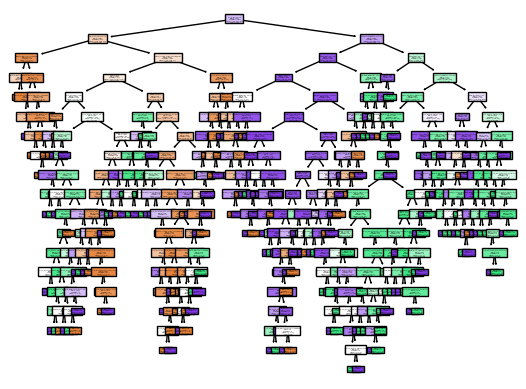

In [114]:
plot_tree(dt_clf_model, feature_names =  df.columns, class_names=["Low", "Medium", "High"], filled=True)
plt.show()

### ALGORITHM 3 : DECISION TREE WITH HYPERPARAMETER TUNNING

In [115]:
hyperparameters = {"criterion" : ["gini", "entropy", "log_loss"],
                   "max_depth" : np.arange(5,15),
                   "min_samples_split" : np.arange(2,10),
                   "min_samples_leaf" : np.arange(2,10)}
hyperparameters

{'criterion': ['gini', 'entropy', 'log_loss'],
 'max_depth': array([ 5,  6,  7,  8,  9, 10, 11, 12, 13, 14]),
 'min_samples_split': array([2, 3, 4, 5, 6, 7, 8, 9]),
 'min_samples_leaf': array([2, 3, 4, 5, 6, 7, 8, 9])}

In [116]:
rscv = RandomizedSearchCV(dt_clf_model, hyperparameters, cv = 5)
rscv = rscv.fit(xtrain, ytrain)
rscv.best_estimator_

DecisionTreeClassifier(criterion='entropy', max_depth=11, min_samples_leaf=2,
                       min_samples_split=9)

In [117]:
dt_clf = DecisionTreeClassifier(criterion='log_loss', max_depth=6, min_samples_leaf=5,
                       min_samples_split=9)

dt_clf_rscv_model = dt_clf.fit(xtrain, ytrain)
dt_clf_rscv_model

DecisionTreeClassifier(criterion='log_loss', max_depth=6, min_samples_leaf=5,
                       min_samples_split=9)

In [118]:
ytrain_pred = dt_clf_rscv_model.predict(xtrain)
print("Training Predictions:", ytrain_pred)


Training Predictions: [2 2 2 ... 1 1 1]


In [119]:
print("*"*60)
print("Model Evaluation for Training Data")
print("*"*60)
acc = accuracy_score(ytrain, ytrain_pred)
print("Accuracy Score : ", acc)
print("-"*60)

conf_mat = confusion_matrix(ytrain, ytrain_pred)
print("Confusion Matrix : \n",conf_mat)
print("-"*60)

multi_conf_mat = multilabel_confusion_matrix(ytrain, ytrain_pred)
print("Multilabel Confusion Matrix : \n",multi_conf_mat)
print("-"*60)


clf_report = classification_report(ytrain, ytrain_pred)
print("Classification Report : \n", clf_report)
print("-"*60)


************************************************************
Model Evaluation for Training Data
************************************************************
Accuracy Score :  0.765625
------------------------------------------------------------
Confusion Matrix : 
 [[296   0  31]
 [ 72 269 100]
 [119  53 660]]
------------------------------------------------------------
Multilabel Confusion Matrix : 
 [[[1082  191]
  [  31  296]]

 [[1106   53]
  [ 172  269]]

 [[ 637  131]
  [ 172  660]]]
------------------------------------------------------------
Classification Report : 
               precision    recall  f1-score   support

           0       0.61      0.91      0.73       327
           1       0.84      0.61      0.71       441
           2       0.83      0.79      0.81       832

    accuracy                           0.77      1600
   macro avg       0.76      0.77      0.75      1600
weighted avg       0.79      0.77      0.77      1600

-------------------------------------

In [120]:
ytest_pred = dt_clf_rscv_model.predict(xtest)

In [121]:
print("*"*60)

print("model evaluation for Testing data")
print("*"*60)
acc = accuracy_score(ytest, ytest_pred)
print("Accuracy Score : ", acc)
print("-"*60)

conf_mat = confusion_matrix(ytest, ytest_pred)
print("Confusion Matrix : \n",conf_mat)
print("-"*60)

multi_conf_mat = multilabel_confusion_matrix(ytest, ytest_pred)
print("Multilabel Confusion Matrix : \n",multi_conf_mat)
print("-"*60)


clf_report = classification_report(ytest, ytest_pred)
print("Classification Report : \n", clf_report)
print("-"*60)


************************************************************
model evaluation for Testing data
************************************************************
Accuracy Score :  0.7025
------------------------------------------------------------
Confusion Matrix : 
 [[ 77   1  10]
 [ 17  59  30]
 [ 46  15 145]]
------------------------------------------------------------
Multilabel Confusion Matrix : 
 [[[249  63]
  [ 11  77]]

 [[278  16]
  [ 47  59]]

 [[154  40]
  [ 61 145]]]
------------------------------------------------------------
Classification Report : 
               precision    recall  f1-score   support

           0       0.55      0.88      0.68        88
           1       0.79      0.56      0.65       106
           2       0.78      0.70      0.74       206

    accuracy                           0.70       400
   macro avg       0.71      0.71      0.69       400
weighted avg       0.73      0.70      0.70       400

----------------------------------------------------

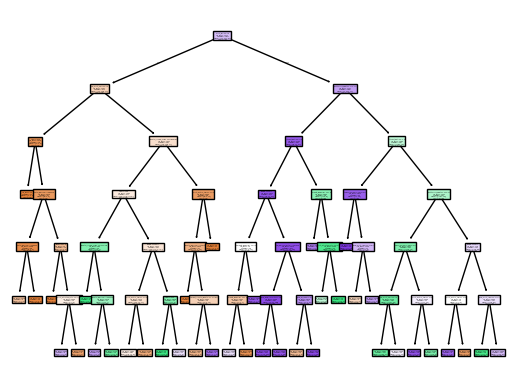

In [122]:
plot_tree(dt_clf_rscv_model, feature_names =  df.columns, class_names=["Low", "Medium", "High"], filled=True)
plt.show()

#### ALGORITHM 4:RANDOM FOREST 

In [123]:

# Initialize the classifier
rf_model = RandomForestClassifier()
rf_model

RandomForestClassifier()

In [124]:
rf_clf_model = rf_model.fit(xtrain,ytrain)
rf_clf_model

RandomForestClassifier()

In [125]:
# Predict on test data
ytrain_pred =rf_clf_model.predict(xtrain)
ytrain_pred

array([2, 2, 2, ..., 1, 1, 1])

In [126]:
print("*"*60)
print("Model Evaluation for Training Data")
print("*"*60)
acc = accuracy_score(ytrain, ytrain_pred)
print("Accuracy Score : ", acc)
print("-"*60)

conf_mat = confusion_matrix(ytrain, ytrain_pred)
print("Confusion Matrix : \n",conf_mat)
print("-"*60)

multi_conf_mat = multilabel_confusion_matrix(ytrain, ytrain_pred)
print("Multilabel Confusion Matrix : \n",multi_conf_mat)
print("-"*60)


clf_report = classification_report(ytrain, ytrain_pred)
print("Classification Report : \n", clf_report)
print("-"*60)


************************************************************
Model Evaluation for Training Data
************************************************************
Accuracy Score :  1.0
------------------------------------------------------------
Confusion Matrix : 
 [[327   0   0]
 [  0 441   0]
 [  0   0 832]]
------------------------------------------------------------
Multilabel Confusion Matrix : 
 [[[1273    0]
  [   0  327]]

 [[1159    0]
  [   0  441]]

 [[ 768    0]
  [   0  832]]]
------------------------------------------------------------
Classification Report : 
               precision    recall  f1-score   support

           0       1.00      1.00      1.00       327
           1       1.00      1.00      1.00       441
           2       1.00      1.00      1.00       832

    accuracy                           1.00      1600
   macro avg       1.00      1.00      1.00      1600
weighted avg       1.00      1.00      1.00      1600

------------------------------------------

In [127]:
ytest_pred = rf_clf_model.predict(xtest)


In [128]:
print("*"*60)

print("model evaluation for Testing data")
print("*"*60)
acc = accuracy_score(ytest, ytest_pred)
print("Accuracy Score : ", acc)
print("-"*60)

conf_mat = confusion_matrix(ytest, ytest_pred)
print("Confusion Matrix : \n",conf_mat)
print("-"*60)

multi_conf_mat = multilabel_confusion_matrix(ytest, ytest_pred)
print("Multilabel Confusion Matrix : \n",multi_conf_mat)
print("-"*60)


clf_report = classification_report(ytest, ytest_pred)
print("Classification Report : \n", clf_report)
print("-"*60)


************************************************************
model evaluation for Testing data
************************************************************
Accuracy Score :  0.815
------------------------------------------------------------
Confusion Matrix : 
 [[ 75   0  13]
 [  0  90  16]
 [ 20  25 161]]
------------------------------------------------------------
Multilabel Confusion Matrix : 
 [[[292  20]
  [ 13  75]]

 [[269  25]
  [ 16  90]]

 [[165  29]
  [ 45 161]]]
------------------------------------------------------------
Classification Report : 
               precision    recall  f1-score   support

           0       0.79      0.85      0.82        88
           1       0.78      0.85      0.81       106
           2       0.85      0.78      0.81       206

    accuracy                           0.81       400
   macro avg       0.81      0.83      0.82       400
weighted avg       0.82      0.81      0.81       400

-----------------------------------------------------

### ALGORITHM 5 : RANDOMFOREST WITH HYPERPARAMETER TUNNING

In [129]:
hyperparameters = {"criterion" : ["gini"],
                   "n_estimators": np.arange(5, 20),
                   "max_depth" : np.arange(5,20),
                   "min_samples_split" : np.arange(2,10),
                   "min_samples_leaf" : np.arange(2,10)}
hyperparameters

{'criterion': ['gini'],
 'n_estimators': array([ 5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19]),
 'max_depth': array([ 5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19]),
 'min_samples_split': array([2, 3, 4, 5, 6, 7, 8, 9]),
 'min_samples_leaf': array([2, 3, 4, 5, 6, 7, 8, 9])}

In [130]:
rscv = RandomizedSearchCV(rf_clf_model, hyperparameters, cv = 5)
rscv = rscv.fit(xtrain, ytrain)
rscv.best_estimator_

RandomForestClassifier(max_depth=17, min_samples_leaf=2, min_samples_split=5,
                       n_estimators=13)

In [131]:
rf_clf = RandomForestClassifier(criterion='gini', max_depth=6, 
                                min_samples_leaf=2, min_samples_split=9)


In [132]:
rf_clf_rscv_model = rf_clf.fit(xtrain, ytrain)
rf_clf_rscv_model


RandomForestClassifier(max_depth=6, min_samples_leaf=2, min_samples_split=9)

In [133]:
# Predict on Training and Test Data
ytrain_pred = rf_clf_rscv_model.predict(xtrain)
ytrain_pred

array([2, 2, 2, ..., 1, 1, 1])

In [134]:
print("*"*60)
print("model evaluation for Training Data")
print("*"*60)
acc = accuracy_score(ytrain, ytrain_pred)
print("Accuracy Score : ", acc)
print("-"*60)

conf_mat = confusion_matrix(ytrain, ytrain_pred)
print("Confusion Matrix : \n",conf_mat)
print("-"*60)

multi_conf_mat = multilabel_confusion_matrix(ytrain, ytrain_pred)
print("Multilabel Confusion Matrix : \n",multi_conf_mat)
print("-"*60)


clf_report = classification_report(ytrain, ytrain_pred)
print("Classification Report : \n", clf_report)
print("-"*60)


************************************************************
model evaluation for Training Data
************************************************************
Accuracy Score :  0.830625
------------------------------------------------------------
Confusion Matrix : 
 [[271   1  55]
 [ 21 387  33]
 [ 73  88 671]]
------------------------------------------------------------
Multilabel Confusion Matrix : 
 [[[1179   94]
  [  56  271]]

 [[1070   89]
  [  54  387]]

 [[ 680   88]
  [ 161  671]]]
------------------------------------------------------------
Classification Report : 
               precision    recall  f1-score   support

           0       0.74      0.83      0.78       327
           1       0.81      0.88      0.84       441
           2       0.88      0.81      0.84       832

    accuracy                           0.83      1600
   macro avg       0.81      0.84      0.82      1600
weighted avg       0.84      0.83      0.83      1600

-------------------------------------

In [135]:
ytest_pred = rf_clf_rscv_model.predict(xtest)

In [136]:
print("*"*60)
print("Model Evaluation For Testing data")
print("*"*60)
acc = accuracy_score(ytest, ytest_pred)
print("Accuracy Score : ", acc)
print("-"*60)

conf_mat = confusion_matrix(ytest, ytest_pred)
print("Confusion Matrix : \n",conf_mat)
print("-"*60)

multi_conf_mat = multilabel_confusion_matrix(ytest, ytest_pred)
print("Multilabel Confusion Matrix : \n",multi_conf_mat)
print("-"*60)


clf_report = classification_report(ytest, ytest_pred)
print("Classification Report : \n", clf_report)
print("-"*60)


************************************************************
Model Evaluation For Testing data
************************************************************
Accuracy Score :  0.7725
------------------------------------------------------------
Confusion Matrix : 
 [[ 81   0   7]
 [  8  82  16]
 [ 33  27 146]]
------------------------------------------------------------
Multilabel Confusion Matrix : 
 [[[271  41]
  [  7  81]]

 [[267  27]
  [ 24  82]]

 [[171  23]
  [ 60 146]]]
------------------------------------------------------------
Classification Report : 
               precision    recall  f1-score   support

           0       0.66      0.92      0.77        88
           1       0.75      0.77      0.76       106
           2       0.86      0.71      0.78       206

    accuracy                           0.77       400
   macro avg       0.76      0.80      0.77       400
weighted avg       0.79      0.77      0.77       400

----------------------------------------------------

#### ALGORITHM 6 : ADABOOST

In [137]:
adb_clf = AdaBoostClassifier()
adb_clf

AdaBoostClassifier()

In [138]:
adb_clf_model = adb_clf.fit(xtrain, ytrain)
adb_clf_model

AdaBoostClassifier()

In [139]:
ytrain_pred = adb_clf_model.predict(xtrain)
ytest_pred = adb_clf_model.predict(xtest)

In [140]:

print("model evaluation for training data")
print("-"*60)
acc = accuracy_score(ytrain, ytrain_pred)
print("Accuracy Score : ", acc)
print("-"*60)

conf_mat = confusion_matrix(ytrain, ytrain_pred)
print("Confusion Matrix : \n",conf_mat)
print("-"*60)

multi_conf_mat = multilabel_confusion_matrix(ytrain, ytrain_pred)
print("Multilabel Confusion Matrix : \n",multi_conf_mat)
print("-"*60)


clf_report = classification_report(ytrain, ytrain_pred)
print("Classification Report : \n", clf_report)
print("-"*60)



model evaluation for training data
------------------------------------------------------------
Accuracy Score :  0.731875
------------------------------------------------------------
Confusion Matrix : 
 [[224   1 102]
 [  6 295 140]
 [ 49 131 652]]
------------------------------------------------------------
Multilabel Confusion Matrix : 
 [[[1218   55]
  [ 103  224]]

 [[1027  132]
  [ 146  295]]

 [[ 526  242]
  [ 180  652]]]
------------------------------------------------------------
Classification Report : 
               precision    recall  f1-score   support

           0       0.80      0.69      0.74       327
           1       0.69      0.67      0.68       441
           2       0.73      0.78      0.76       832

    accuracy                           0.73      1600
   macro avg       0.74      0.71      0.72      1600
weighted avg       0.73      0.73      0.73      1600

------------------------------------------------------------


In [141]:
print("model evaluation for Testing data")
print("-"*60)
acc = accuracy_score(ytest, ytest_pred)
print("Accuracy Score : ", acc)
print("-"*60)

conf_mat = confusion_matrix(ytest, ytest_pred)
print("Confusion Matrix : \n",conf_mat)
print("-"*60)

multi_conf_mat = multilabel_confusion_matrix(ytest, ytest_pred)
print("Multilabel Confusion Matrix : \n",multi_conf_mat)
print("-"*60)


clf_report = classification_report(ytest, ytest_pred)
print("Classification Report : \n", clf_report)
print("-"*60)

model evaluation for Testing data
------------------------------------------------------------
Accuracy Score :  0.7175
------------------------------------------------------------
Confusion Matrix : 
 [[ 57   0  31]
 [  2  73  31]
 [ 17  32 157]]
------------------------------------------------------------
Multilabel Confusion Matrix : 
 [[[293  19]
  [ 31  57]]

 [[262  32]
  [ 33  73]]

 [[132  62]
  [ 49 157]]]
------------------------------------------------------------
Classification Report : 
               precision    recall  f1-score   support

           0       0.75      0.65      0.70        88
           1       0.70      0.69      0.69       106
           2       0.72      0.76      0.74       206

    accuracy                           0.72       400
   macro avg       0.72      0.70      0.71       400
weighted avg       0.72      0.72      0.72       400

------------------------------------------------------------


### ALGORITHM 7 : ADABOOST WITH HYPERPARAMETER TUNNING

In [142]:
hyperparameters= {"n_estimators" : np.arange(2,51), 
       "learning_rate" : [0,0.1,0.001,0.1,1]
      }

hyperparameters

{'n_estimators': array([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
        19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
        36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50]),
 'learning_rate': [0, 0.1, 0.001, 0.1, 1]}

In [143]:
rscv_adb = RandomizedSearchCV(adb_clf_model, hyperparameters, cv = 5)
rscv_adb.fit(xtrain, ytrain).best_estimator_

AdaBoostClassifier(learning_rate=1, n_estimators=44)

In [144]:
rscv_adb_clf =AdaBoostClassifier(learning_rate=1, n_estimators=49)
rscv_adb_clf_model = rscv_adb_clf.fit(xtrain, ytrain)
rscv_adb_clf_model

AdaBoostClassifier(learning_rate=1, n_estimators=49)

In [145]:
ytrain_pred = rscv_adb_clf_model.predict(xtrain)
ytest_pred = rscv_adb_clf_model.predict(xtest)

In [146]:
print("model evaluation for training data")
print("-"*60)
acc = accuracy_score(ytrain, ytrain_pred)
print("Accuracy Score : ", acc)
print("-"*60)

conf_mat = confusion_matrix(ytrain, ytrain_pred)
print("Confusion Matrix : \n",conf_mat)
print("-"*60)

multi_conf_mat = multilabel_confusion_matrix(ytrain, ytrain_pred)
print("Multilabel Confusion Matrix : \n",multi_conf_mat)
print("-"*60)


clf_report = classification_report(ytrain, ytrain_pred)
print("Classification Report : \n", clf_report)
print("-"*60)



model evaluation for training data
------------------------------------------------------------
Accuracy Score :  0.7225
------------------------------------------------------------
Confusion Matrix : 
 [[218   1 108]
 [  9 299 133]
 [ 50 143 639]]
------------------------------------------------------------
Multilabel Confusion Matrix : 
 [[[1214   59]
  [ 109  218]]

 [[1015  144]
  [ 142  299]]

 [[ 527  241]
  [ 193  639]]]
------------------------------------------------------------
Classification Report : 
               precision    recall  f1-score   support

           0       0.79      0.67      0.72       327
           1       0.67      0.68      0.68       441
           2       0.73      0.77      0.75       832

    accuracy                           0.72      1600
   macro avg       0.73      0.70      0.71      1600
weighted avg       0.72      0.72      0.72      1600

------------------------------------------------------------


In [147]:
print("model evaluation for Testing data")
print("-"*60)
acc = accuracy_score(ytest, ytest_pred)
print("Accuracy Score : ", acc)
print("-"*60)

conf_mat = confusion_matrix(ytest, ytest_pred)
print("Confusion Matrix : \n",conf_mat)
print("-"*60)

multi_conf_mat = multilabel_confusion_matrix(ytest, ytest_pred)
print("Multilabel Confusion Matrix : \n",multi_conf_mat)
print("-"*60)


clf_report = classification_report(ytest, ytest_pred)
print("Classification Report : \n", clf_report)
print("-"*60)

model evaluation for Testing data
------------------------------------------------------------
Accuracy Score :  0.7075
------------------------------------------------------------
Confusion Matrix : 
 [[ 55   0  33]
 [  3  74  29]
 [ 17  35 154]]
------------------------------------------------------------
Multilabel Confusion Matrix : 
 [[[292  20]
  [ 33  55]]

 [[259  35]
  [ 32  74]]

 [[132  62]
  [ 52 154]]]
------------------------------------------------------------
Classification Report : 
               precision    recall  f1-score   support

           0       0.73      0.62      0.67        88
           1       0.68      0.70      0.69       106
           2       0.71      0.75      0.73       206

    accuracy                           0.71       400
   macro avg       0.71      0.69      0.70       400
weighted avg       0.71      0.71      0.71       400

------------------------------------------------------------


### ALGORITHM 8 : GRADIENTBOOST

In [148]:
gdb_clf = GradientBoostingClassifier()
gdb_clf

GradientBoostingClassifier()

In [149]:
gdb_clf_model = gdb_clf.fit(xtrain, ytrain)
gdb_clf_model

GradientBoostingClassifier()

In [150]:
ytrain_pred = gdb_clf_model.predict(xtrain)
ytest_pred = gdb_clf_model.predict(xtest)

In [151]:
print("model evaluation for training data")
print("-"*60)
acc = accuracy_score(ytrain, ytrain_pred)
print("Accuracy Score : ", acc)
print("-"*60)

conf_mat = confusion_matrix(ytrain, ytrain_pred)
print("Confusion Matrix : \n",conf_mat)
print("-"*60)

multi_conf_mat = multilabel_confusion_matrix(ytrain, ytrain_pred)
print("Multilabel Confusion Matrix : \n",multi_conf_mat)
print("-"*60)


clf_report = classification_report(ytrain, ytrain_pred)
print("Classification Report : \n", clf_report)
print("-"*60)



model evaluation for training data
------------------------------------------------------------
Accuracy Score :  0.903125
------------------------------------------------------------
Confusion Matrix : 
 [[300   0  27]
 [  3 410  28]
 [ 36  61 735]]
------------------------------------------------------------
Multilabel Confusion Matrix : 
 [[[1234   39]
  [  27  300]]

 [[1098   61]
  [  31  410]]

 [[ 713   55]
  [  97  735]]]
------------------------------------------------------------
Classification Report : 
               precision    recall  f1-score   support

           0       0.88      0.92      0.90       327
           1       0.87      0.93      0.90       441
           2       0.93      0.88      0.91       832

    accuracy                           0.90      1600
   macro avg       0.90      0.91      0.90      1600
weighted avg       0.90      0.90      0.90      1600

------------------------------------------------------------


In [152]:
print("model evaluation for Testing data")
print("-"*60)
acc = accuracy_score(ytest, ytest_pred)
print("Accuracy Score : ", acc)
print("-"*60)

conf_mat = confusion_matrix(ytest, ytest_pred)
print("Confusion Matrix : \n",conf_mat)
print("-"*60)

multi_conf_mat = multilabel_confusion_matrix(ytest, ytest_pred)
print("Multilabel Confusion Matrix : \n",multi_conf_mat)
print("-"*60)


clf_report = classification_report(ytest, ytest_pred)
print("Classification Report : \n", clf_report)
print("-"*60)

model evaluation for Testing data
------------------------------------------------------------
Accuracy Score :  0.8025
------------------------------------------------------------
Confusion Matrix : 
 [[ 76   0  12]
 [  3  84  19]
 [ 20  25 161]]
------------------------------------------------------------
Multilabel Confusion Matrix : 
 [[[289  23]
  [ 12  76]]

 [[269  25]
  [ 22  84]]

 [[163  31]
  [ 45 161]]]
------------------------------------------------------------
Classification Report : 
               precision    recall  f1-score   support

           0       0.77      0.86      0.81        88
           1       0.77      0.79      0.78       106
           2       0.84      0.78      0.81       206

    accuracy                           0.80       400
   macro avg       0.79      0.81      0.80       400
weighted avg       0.80      0.80      0.80       400

------------------------------------------------------------


### ALGORITHM 9 : GRADIENTBOOST WITH HYPERPARAMETER TUNNING

In [153]:
hyperparameters= {"n_estimators" : np.arange(2,51), 
       "learning_rate" : [0,0.1,0.001,0.1,1]
      }

hyperparameters

{'n_estimators': array([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
        19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
        36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50]),
 'learning_rate': [0, 0.1, 0.001, 0.1, 1]}

In [154]:
rscv_gdb = RandomizedSearchCV(gdb_clf_model, hyperparameters, cv = 5)
rscv_gdb.fit(xtrain, ytrain).best_estimator_

GradientBoostingClassifier(learning_rate=1, n_estimators=28)

In [155]:
rscv_gdb_clf =GradientBoostingClassifier(n_estimators=46)
rscv_gdb_clf_model = rscv_gdb_clf.fit(xtrain, ytrain)
rscv_gdb_clf_model

GradientBoostingClassifier(n_estimators=46)

In [156]:
ytrain_pred = rscv_gdb_clf_model.predict(xtrain)
ytest_pred = rscv_gdb_clf_model.predict(xtest)

In [157]:
print("model evaluation for training data")
print("-"*60)
acc = accuracy_score(ytrain, ytrain_pred)
print("Accuracy Score : ", acc)
print("-"*60)

conf_mat = confusion_matrix(ytrain, ytrain_pred)
print("Confusion Matrix : \n",conf_mat)
print("-"*60)

multi_conf_mat = multilabel_confusion_matrix(ytrain, ytrain_pred)
print("Multilabel Confusion Matrix : \n",multi_conf_mat)
print("-"*60)


clf_report = classification_report(ytrain, ytrain_pred)
print("Classification Report : \n", clf_report)
print("-"*60)



model evaluation for training data
------------------------------------------------------------
Accuracy Score :  0.85625
------------------------------------------------------------
Confusion Matrix : 
 [[283   0  44]
 [ 14 388  39]
 [ 60  73 699]]
------------------------------------------------------------
Multilabel Confusion Matrix : 
 [[[1199   74]
  [  44  283]]

 [[1086   73]
  [  53  388]]

 [[ 685   83]
  [ 133  699]]]
------------------------------------------------------------
Classification Report : 
               precision    recall  f1-score   support

           0       0.79      0.87      0.83       327
           1       0.84      0.88      0.86       441
           2       0.89      0.84      0.87       832

    accuracy                           0.86      1600
   macro avg       0.84      0.86      0.85      1600
weighted avg       0.86      0.86      0.86      1600

------------------------------------------------------------


In [158]:
print("model evaluation for Testing data")
print("-"*60)
acc = accuracy_score(ytest, ytest_pred)
print("Accuracy Score : ", acc)
print("-"*60)

conf_mat = confusion_matrix(ytest, ytest_pred)
print("Confusion Matrix : \n",conf_mat)
print("-"*60)

multi_conf_mat = multilabel_confusion_matrix(ytest, ytest_pred)
print("Multilabel Confusion Matrix : \n",multi_conf_mat)
print("-"*60)


clf_report = classification_report(ytest, ytest_pred)
print("Classification Report : \n", clf_report)
print("-"*60)

model evaluation for Testing data
------------------------------------------------------------
Accuracy Score :  0.7875
------------------------------------------------------------
Confusion Matrix : 
 [[ 77   0  11]
 [  5  82  19]
 [ 25  25 156]]
------------------------------------------------------------
Multilabel Confusion Matrix : 
 [[[282  30]
  [ 11  77]]

 [[269  25]
  [ 24  82]]

 [[164  30]
  [ 50 156]]]
------------------------------------------------------------
Classification Report : 
               precision    recall  f1-score   support

           0       0.72      0.88      0.79        88
           1       0.77      0.77      0.77       106
           2       0.84      0.76      0.80       206

    accuracy                           0.79       400
   macro avg       0.77      0.80      0.79       400
weighted avg       0.79      0.79      0.79       400

------------------------------------------------------------


### ALGORITHM 10 : XGBOOST 

In [159]:
xgb_clf = XGBClassifier()
xgb_clf

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, random_state=None, ...)

In [160]:
xgb_clf_model = xgb_clf.fit(xtrain, ytrain)
xgb_clf_model

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, objective='multi:softprob', ...)

In [161]:
ytrain_pred = xgb_clf_model.predict(xtrain)
ytest_pred = xgb_clf_model.predict(xtest)

In [162]:
print("model evaluation for training data")
print("-"*60)
acc = accuracy_score(ytrain, ytrain_pred)
print("Accuracy Score : ", acc)
print("-"*60)

conf_mat = confusion_matrix(ytrain, ytrain_pred)
print("Confusion Matrix : \n",conf_mat)
print("-"*60)

multi_conf_mat = multilabel_confusion_matrix(ytrain, ytrain_pred)
print("Multilabel Confusion Matrix : \n",multi_conf_mat)
print("-"*60)


clf_report = classification_report(ytrain, ytrain_pred)
print("Classification Report : \n", clf_report)
print("-"*60)



model evaluation for training data
------------------------------------------------------------
Accuracy Score :  1.0
------------------------------------------------------------
Confusion Matrix : 
 [[327   0   0]
 [  0 441   0]
 [  0   0 832]]
------------------------------------------------------------
Multilabel Confusion Matrix : 
 [[[1273    0]
  [   0  327]]

 [[1159    0]
  [   0  441]]

 [[ 768    0]
  [   0  832]]]
------------------------------------------------------------
Classification Report : 
               precision    recall  f1-score   support

           0       1.00      1.00      1.00       327
           1       1.00      1.00      1.00       441
           2       1.00      1.00      1.00       832

    accuracy                           1.00      1600
   macro avg       1.00      1.00      1.00      1600
weighted avg       1.00      1.00      1.00      1600

------------------------------------------------------------


In [163]:
print("model evaluation for Testing data")
print("-"*60)
acc = accuracy_score(ytest, ytest_pred)
print("Accuracy Score : ", acc)
print("-"*60)

conf_mat = confusion_matrix(ytest, ytest_pred)
print("Confusion Matrix : \n",conf_mat)
print("-"*60)

multi_conf_mat = multilabel_confusion_matrix(ytest, ytest_pred)
print("Multilabel Confusion Matrix : \n",multi_conf_mat)
print("-"*60)


clf_report = classification_report(ytest, ytest_pred)
print("Classification Report : \n", clf_report)
print("-"*60)

model evaluation for Testing data
------------------------------------------------------------
Accuracy Score :  0.815
------------------------------------------------------------
Confusion Matrix : 
 [[ 78   0  10]
 [  0  83  23]
 [ 18  23 165]]
------------------------------------------------------------
Multilabel Confusion Matrix : 
 [[[294  18]
  [ 10  78]]

 [[271  23]
  [ 23  83]]

 [[161  33]
  [ 41 165]]]
------------------------------------------------------------
Classification Report : 
               precision    recall  f1-score   support

           0       0.81      0.89      0.85        88
           1       0.78      0.78      0.78       106
           2       0.83      0.80      0.82       206

    accuracy                           0.81       400
   macro avg       0.81      0.82      0.82       400
weighted avg       0.82      0.81      0.81       400

------------------------------------------------------------


### ALGORITHM 11 : XGBOOST WITH HYPERPARAMETER TUNNING

In [164]:
hyperparameters= {"n_estimators" : np.arange(2,51), 
       "learning_rate" : [0,0.1,0.001,0.1,1]
      }

hyperparameters

{'n_estimators': array([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
        19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
        36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50]),
 'learning_rate': [0, 0.1, 0.001, 0.1, 1]}

In [165]:
rscv_xgb = RandomizedSearchCV(xgb_clf_model, hyperparameters, cv = 5)
rscv_xgb.fit(xtrain, ytrain).best_estimator_

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=1, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=48, n_jobs=None,
              num_parallel_tree=None, objective='multi:softprob', ...)

In [166]:
rscv_xgb_clf =XGBClassifier(learning_rate=0.1, n_estimators=4)
rscv_xgb_clf_model = rscv_xgb_clf.fit(xtrain, ytrain)
rscv_xgb_clf_model

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.1, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=4, n_jobs=None,
              num_parallel_tree=None, objective='multi:softprob', ...)

In [167]:
ytrain_pred = rscv_xgb_clf_model.predict(xtrain)
ytest_pred = rscv_xgb_clf_model.predict(xtest)

In [168]:
print("model evaluation for training data")
print("-"*60)
acc = accuracy_score(ytrain, ytrain_pred)
print("Accuracy Score : ", acc)
print("-"*60)

conf_mat = confusion_matrix(ytrain, ytrain_pred)
print("Confusion Matrix : \n",conf_mat)
print("-"*60)

multi_conf_mat = multilabel_confusion_matrix(ytrain, ytrain_pred)
print("Multilabel Confusion Matrix : \n",multi_conf_mat)
print("-"*60)


clf_report = classification_report(ytrain, ytrain_pred)
print("Classification Report : \n", clf_report)
print("-"*60)



model evaluation for training data
------------------------------------------------------------
Accuracy Score :  0.8625
------------------------------------------------------------
Confusion Matrix : 
 [[289   9  29]
 [ 10 394  37]
 [ 51  84 697]]
------------------------------------------------------------
Multilabel Confusion Matrix : 
 [[[1212   61]
  [  38  289]]

 [[1066   93]
  [  47  394]]

 [[ 702   66]
  [ 135  697]]]
------------------------------------------------------------
Classification Report : 
               precision    recall  f1-score   support

           0       0.83      0.88      0.85       327
           1       0.81      0.89      0.85       441
           2       0.91      0.84      0.87       832

    accuracy                           0.86      1600
   macro avg       0.85      0.87      0.86      1600
weighted avg       0.87      0.86      0.86      1600

------------------------------------------------------------


In [169]:
print("model evaluation for Testing data")
print("-"*60)
acc = accuracy_score(ytest, ytest_pred)
print("Accuracy Score : ", acc)
print("-"*60)

conf_mat = confusion_matrix(ytest, ytest_pred)
print("Confusion Matrix : \n",conf_mat)
print("-"*60)

multi_conf_mat = multilabel_confusion_matrix(ytest, ytest_pred)
print("Multilabel Confusion Matrix : \n",multi_conf_mat)
print("-"*60)


clf_report = classification_report(ytest, ytest_pred)
print("Classification Report : \n", clf_report)
print("-"*60)

model evaluation for Testing data
------------------------------------------------------------
Accuracy Score :  0.7675
------------------------------------------------------------
Confusion Matrix : 
 [[ 69   7  12]
 [  4  84  18]
 [ 24  28 154]]
------------------------------------------------------------
Multilabel Confusion Matrix : 
 [[[284  28]
  [ 19  69]]

 [[259  35]
  [ 22  84]]

 [[164  30]
  [ 52 154]]]
------------------------------------------------------------
Classification Report : 
               precision    recall  f1-score   support

           0       0.71      0.78      0.75        88
           1       0.71      0.79      0.75       106
           2       0.84      0.75      0.79       206

    accuracy                           0.77       400
   macro avg       0.75      0.77      0.76       400
weighted avg       0.77      0.77      0.77       400

------------------------------------------------------------


### ALGORITHM 12 : KNN ALGORITHM

In [170]:
knn_clf = KNeighborsClassifier(n_neighbors=3)
knn_clf

KNeighborsClassifier(n_neighbors=3)

In [171]:
knn_clf_model = knn_clf.fit(xtrain,ytrain)
knn_clf_model

KNeighborsClassifier(n_neighbors=3)

In [172]:
ypred_train = knn_clf_model.predict(xtrain)

Accuracy =  0.89
              precision    recall  f1-score   support

           0       0.86      0.92      0.89       327
           1       0.85      0.94      0.89       441
           2       0.93      0.85      0.89       832

    accuracy                           0.89      1600
   macro avg       0.88      0.90      0.89      1600
weighted avg       0.89      0.89      0.89      1600



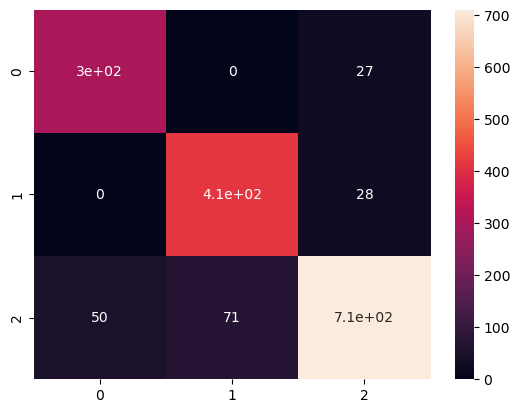

In [173]:
#training
print("Accuracy = ",accuracy_score(ytrain,ypred_train))
sns.heatmap(confusion_matrix(ytrain,ypred_train),annot=True)
print(classification_report(ytrain,ypred_train))

Accuracy = 0.8075
              precision    recall  f1-score   support

           0       0.77      0.93      0.85        88
           1       0.75      0.84      0.79       106
           2       0.87      0.74      0.80       206

    accuracy                           0.81       400
   macro avg       0.80      0.84      0.81       400
weighted avg       0.82      0.81      0.81       400



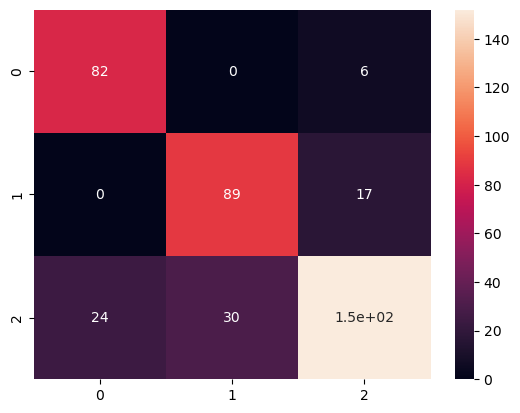

In [174]:
#testing
ypred_test = knn_clf_model.predict(xtest)
print(f"Accuracy = {accuracy_score(ytest,ypred_test)}")
sns.heatmap(confusion_matrix(ytest,ypred_test),annot=True)
print(classification_report(ytest,ypred_test))

In [175]:
training_accuracy = []
testing_accuracy = []


for k in np.arange(2,20):
    knn_clf = KNeighborsClassifier(k)
    knn_clf_model = knn_clf.fit(xtrain,ytrain)

   # Training Data Evaluation
    y_pred_train = knn_clf_model.predict(xtrain)

    cnf_matrix = confusion_matrix(ytrain, y_pred_train)
    print("Confusion Matrix :\n",cnf_matrix)
    print("*"*60)

    accuracy = accuracy_score(ytrain, y_pred_train)
    print("Accuracy :",accuracy)
    print("*"*60)

    clf_report = classification_report(ytrain, y_pred_train)
    print("Classification Report :\n",clf_report)
    
    training_accuracy.append(accuracy)
    
    # Testing Data Evaluation
    ypred = knn_clf_model.predict(xtest)

    cnf_matrix = confusion_matrix(ytest, ypred)
    print("Confusion Matrix :\n",cnf_matrix)
    print("*"*60)

    accuracy = accuracy_score(ytest, ypred)
    print("Accuracy :",accuracy)
    print("*"*60)

    clf_report = classification_report(ytest, ypred)
    print("Classification Report :\n",clf_report)

    testing_accuracy.append(accuracy)

Confusion Matrix :
 [[327   0   0]
 [  0 441   0]
 [ 85 108 639]]
************************************************************
Accuracy : 0.879375
************************************************************
Classification Report :
               precision    recall  f1-score   support

           0       0.79      1.00      0.88       327
           1       0.80      1.00      0.89       441
           2       1.00      0.77      0.87       832

    accuracy                           0.88      1600
   macro avg       0.87      0.92      0.88      1600
weighted avg       0.90      0.88      0.88      1600

Confusion Matrix :
 [[ 85   0   3]
 [  0  95  11]
 [ 31  39 136]]
************************************************************
Accuracy : 0.79
************************************************************
Classification Report :
               precision    recall  f1-score   support

           0       0.73      0.97      0.83        88
           1       0.71      0.90      0.79     

### ALGORITHM 13 : KNN WITH HYPERPARAMETER TUNNING

In [176]:
hyp = {
    "n_neighbors":np.arange(2,20),
    "p" : [1,2]
}

hyp

{'n_neighbors': array([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
        19]),
 'p': [1, 2]}

In [177]:
rscv_knn_clf_model = RandomizedSearchCV(knn_clf_model, hyp, cv = 6)
rscv_knn_clf_model.fit(xtrain,ytrain)
rscv_knn_clf_model.best_estimator_

KNeighborsClassifier(n_neighbors=2, p=1)

In [178]:
knn_clf = KNeighborsClassifier(n_neighbors=2)

knn_clf

KNeighborsClassifier(n_neighbors=2)

In [179]:
knn_clf.fit(xtrain,ytrain)

KNeighborsClassifier(n_neighbors=2)

In [180]:
# Training Data Evaluation
y_pred_train = knn_clf.predict(xtrain)

cnf_matrix = confusion_matrix(ytrain, y_pred_train)
print("Confusion Matrix :\n",cnf_matrix)
print("*"*60)

accuracy = accuracy_score(ytrain, y_pred_train)
print("Accuracy :",accuracy)
print("*"*60)

clf_report = classification_report(ytrain, y_pred_train)
print("Classification Report :\n",clf_report)

Confusion Matrix :
 [[327   0   0]
 [  0 441   0]
 [ 85 108 639]]
************************************************************
Accuracy : 0.879375
************************************************************
Classification Report :
               precision    recall  f1-score   support

           0       0.79      1.00      0.88       327
           1       0.80      1.00      0.89       441
           2       1.00      0.77      0.87       832

    accuracy                           0.88      1600
   macro avg       0.87      0.92      0.88      1600
weighted avg       0.90      0.88      0.88      1600



In [181]:
# Testing Data Evaluation
ypred = knn_clf.predict(xtest)

cnf_matrix = confusion_matrix(ytest, ypred)
print("Confusion Matrix :\n",cnf_matrix)
print("*"*60)

accuracy = accuracy_score(ytest, ypred)
print("Accuracy :",accuracy)
print("*"*60)

clf_report = classification_report(ytest, ypred)
print("Classification Report :\n",clf_report)

Confusion Matrix :
 [[ 85   0   3]
 [  0  95  11]
 [ 31  39 136]]
************************************************************
Accuracy : 0.79
************************************************************
Classification Report :
               precision    recall  f1-score   support

           0       0.73      0.97      0.83        88
           1       0.71      0.90      0.79       106
           2       0.91      0.66      0.76       206

    accuracy                           0.79       400
   macro avg       0.78      0.84      0.80       400
weighted avg       0.82      0.79      0.79       400



Text(0.5, 0, 'K values')

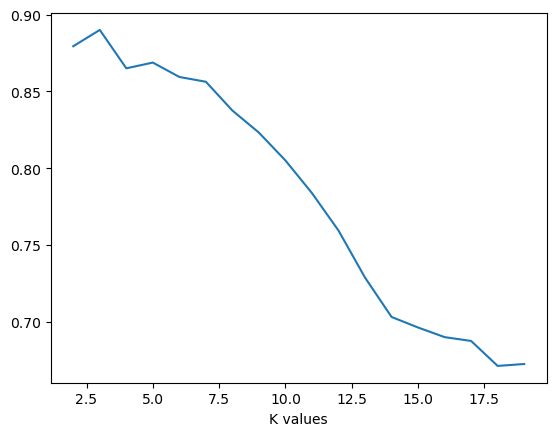

In [182]:
k = np.arange(2, 20)
sns.lineplot(x=k,y=training_accuracy)
plt.xlabel("K values")

Text(0.5, 0, 'K values')

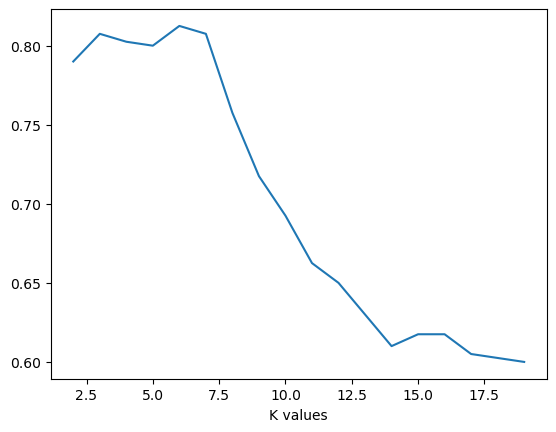

In [183]:
k = np.arange(2, 20)
sns.lineplot(x=k,y=testing_accuracy)
plt.xlabel("K values")

#### SVM Algorithm

In [184]:
svc = SVC()
svm_model = svc.fit(xtrain, ytrain)
svm_model

SVC()

In [185]:
ytrain_pred = svm_model.predict(xtrain)
ytest_pred = svm_model.predict(xtest)

In [186]:

print("model evaluation for training data")
print("-"*60)
acc = accuracy_score(ytrain, ytrain_pred)
print("Accuracy Score : ", acc)
print("-"*60)

conf_mat = confusion_matrix(ytrain, ytrain_pred)
print("Confusion Matrix : \n",conf_mat)
print("-"*60)


clf_report = classification_report(ytrain, ytrain_pred)
print("Classification Report : \n", clf_report)
print("-"*60)




model evaluation for training data
------------------------------------------------------------
Accuracy Score :  0.525625
------------------------------------------------------------
Confusion Matrix : 
 [[ 21   0 306]
 [  0   0 441]
 [ 12   0 820]]
------------------------------------------------------------
Classification Report : 
               precision    recall  f1-score   support

           0       0.64      0.06      0.12       327
           1       0.00      0.00      0.00       441
           2       0.52      0.99      0.68       832

    accuracy                           0.53      1600
   macro avg       0.39      0.35      0.27      1600
weighted avg       0.40      0.53      0.38      1600

------------------------------------------------------------


In [187]:
print("model evaluation for Testing data")
print("-"*60)
acc = accuracy_score(ytest, ytest_pred)
print("Accuracy Score : ", acc)
print("-"*60)

conf_mat = confusion_matrix(ytest, ytest_pred)
print("Confusion Matrix : \n",conf_mat)
print("-"*60)


clf_report = classification_report(ytest, ytest_pred)
print("Classification Report : \n", clf_report)
print("-"*60)

model evaluation for Testing data
------------------------------------------------------------
Accuracy Score :  0.5225
------------------------------------------------------------
Confusion Matrix : 
 [[  5   0  83]
 [  0   0 106]
 [  2   0 204]]
------------------------------------------------------------
Classification Report : 
               precision    recall  f1-score   support

           0       0.71      0.06      0.11        88
           1       0.00      0.00      0.00       106
           2       0.52      0.99      0.68       206

    accuracy                           0.52       400
   macro avg       0.41      0.35      0.26       400
weighted avg       0.42      0.52      0.37       400

------------------------------------------------------------


#### SAVE BEST MODEL IN PICKLE FILE

In [188]:
import pickle

In [210]:
with open("CreditScore_Model.pkl","wb") as f:
    pickle.dump(dt_clf_rscv_model,f)

In [211]:
test_data = xtrain.head(2)
test_data

,Month,Name,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Credit_History_Age,Total_Emi_Per_Month,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_Of_Loan,Type_Of_Loan,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Amount_Invested_Monthly,Payment_Behaviour,Monthly_Balance
811,0,18,18,7,56803.71,4620.6426,24,187.19022,7,5.0,25,6.0,105,11,2,2593.44,32.078530,186.06856,2,348.805480
1631,1,113,27,13,96582.24,7886.5200,106,72.46021,3,3.0,13,1.0,20,0,1,482.88,36.153908,115.29322,0,795.603509


In [212]:
with open("CreditScore_Model.pkl","rb") as f:
    Final_Model = pickle.load(f)

In [213]:
Final_Model.predict(test_data)[0]

2

In [193]:
def MyPrediction(Month, Name, Age, Occupation, Annual_Income, Monthly_Inhand_Salary,
                 Credit_History_Age, Total_Emi_Per_Month, Num_Bank_Accounts, Num_Credit_Card,
                 Interest_Rate, Num_Of_Loan, Type_Of_Loan, Num_Credit_Inquiries, Credit_Mix,
                 Outstanding_Debt, Credit_Utilization_Ratio, Amount_Invested_Monthly,
                 Payment_Behaviour, Monthly_Balance):

    test_Data = pd.DataFrame({
        'Month': [Month],
        'Name': [Name],
        'Age': [Age],
        'Occupation': [Occupation],
        'Annual_Income': [Annual_Income],
        'Monthly_Inhand_Salary': [Monthly_Inhand_Salary],
        'Credit_History_Age': [Credit_History_Age],
        'Total_Emi_Per_Month': [Total_Emi_Per_Month],
        'Num_Bank_Accounts': [Num_Bank_Accounts],
        'Num_Credit_Card': [Num_Credit_Card],
        'Interest_Rate': [Interest_Rate],
        'Num_Of_Loan': [Num_Of_Loan],
        'Type_Of_Loan': [Type_Of_Loan],
        'Num_Credit_Inquiries': [Num_Credit_Inquiries],
        'Credit_Mix': [Credit_Mix],
        'Outstanding_Debt': [Outstanding_Debt],
        'Credit_Utilization_Ratio': [Credit_Utilization_Ratio],
        'Amount_Invested_Monthly': [Amount_Invested_Monthly],
        'Payment_Behaviour': [Payment_Behaviour],
        'Monthly_Balance': [Monthly_Balance]
    })
    print("New Data\n",test_Data)


   
    # Load the trained model
    with open("CreditScore_Model.pkl","rb") as f:
        Final_Model = pickle.load(f)

    # Make a prediction
    prediction = Final_Model.predict(test_Data)[0]

    # Output prediction result
    if prediction == 0:
        print("Predicted Credit Score: Score - Low")
    elif prediction == 1:
        print("Predicted Credit Score: Score - Medium")
    else:
        print("Predicted Credit Score: Score - High")

In [194]:
MyPrediction(0.0,	18,	18,	7.0	,56803.71,	4620.6426,	24.0,	187.19022, 7.0,	5.0,	25,	6.0,	105,	11,	0,	2593.44,	32.07853,	186.06856,	2,	348.80548)


New Data
    Month  Name  Age  Occupation  Annual_Income  Monthly_Inhand_Salary  \
0    0.0    18   18         7.0       56803.71              4620.6426   

   Credit_History_Age  Total_Emi_Per_Month  Num_Bank_Accounts  \
0                24.0            187.19022                7.0   

   Num_Credit_Card  Interest_Rate  Num_Of_Loan  Type_Of_Loan  \
0              5.0             25          6.0           105   

   Num_Credit_Inquiries  Credit_Mix  Outstanding_Debt  \
0                    11           0           2593.44   

   Credit_Utilization_Ratio  Amount_Invested_Monthly  Payment_Behaviour  \
0                  32.07853                186.06856                  2   

   Monthly_Balance  
0        348.80548  
Predicted Credit Score: Score - High


In [216]:
%%writefile Credit_Score_Prediction_app.py
import streamlit as st
import pickle
import pandas as pd

# Load the trained model
with open("CreditScore_Model.pkl", "rb") as file:
    model = pickle.load(file)

# Get the feature names the model expects
expected_features = model.feature_names_in_
st.write("Model expects these features:", expected_features)

# Define the Streamlit app
st.title("Credit Score Prediction App")

# Create input fields
month = st.selectbox("Month", list(range(1, 13)))
age = st.number_input("Age", min_value=18, max_value=100, step=1)
occupation = st.selectbox("Occupation", ["Salaried", "Self-Employed", "Business", "Unemployed"])
annual_income = st.number_input("Annual Income", min_value=0.0, step=1000.0)
monthly_inhand_salary = st.number_input("Monthly Inhand Salary", min_value=0.0, step=500.0)
credit_history_age = st.number_input("Credit History Age (in years)", min_value=0.0, step=0.5)
total_emi_per_month = st.number_input("Total EMI per Month", min_value=0.0, step=100.0)
num_bank_accounts = st.number_input("Number of Bank Accounts", min_value=0, step=1)
num_credit_card = st.number_input("Number of Credit Cards", min_value=0, step=1)
interest_rate = st.number_input("Interest Rate", min_value=0.0, step=0.1)
num_of_loan = st.number_input("Number of Loans", min_value=0, step=1)
type_of_loan = st.selectbox("Type of Loan", ["Home Loan", "Car Loan", "Personal Loan", "Credit Card Loan", "Other"])
num_credit_inquiries = st.number_input("Number of Credit Inquiries", min_value=0, step=1)
credit_mix = st.selectbox("Credit Mix", ["Good", "Standard", "Poor"])
outstanding_debt = st.number_input("Outstanding Debt", min_value=0.0, step=100.0)
credit_utilization_ratio = st.number_input("Credit Utilization Ratio", min_value=0.0, step=1.0)
amount_invested_monthly = st.number_input("Amount Invested Monthly", min_value=0.0, step=100.0)
payment_behaviour = st.selectbox("Payment Behaviour", ["Low Spend", "High Spend", "Moderate Spend"])
monthly_balance = st.number_input("Monthly Balance", min_value=0.0, step=100.0)

# Encode categorical variables
occupation_mapping = {"Salaried": 0, "Self-Employed": 1, "Business": 2, "Unemployed": 3}
type_of_loan_mapping = {"Home Loan": 0, "Car Loan": 1, "Personal Loan": 2, "Credit Card Loan": 3, "Other": 4}
credit_mix_mapping = {"Good": 0, "Standard": 1, "Poor": 2}
payment_behaviour_mapping = {"Low Spend": 0, "High Spend": 1, "Moderate Spend": 2}

# Prepare input data for model
input_data = pd.DataFrame({
    'Month': [month],
    'Age': [age],
    'Occupation': [occupation_mapping.get(occupation, -1)],
    'Annual_Income': [annual_income],
    'Monthly_Inhand_Salary': [monthly_inhand_salary],
    'Credit_History_Age': [credit_history_age],
    'Total_Emi_Per_Month': [total_emi_per_month],
    'Num_Bank_Accounts': [num_bank_accounts],
    'Num_Credit_Card': [num_credit_card],
    'Interest_Rate': [interest_rate],
    'Num_Of_Loan': [num_of_loan],
    'Type_Of_Loan': [type_of_loan_mapping.get(type_of_loan, -1)],
    'Num_Credit_Inquiries': [num_credit_inquiries],
    'Credit_Mix': [credit_mix_mapping.get(credit_mix, -1)],
    'Outstanding_Debt': [outstanding_debt],
    'Credit_Utilization_Ratio': [credit_utilization_ratio],
    'Amount_Invested_Monthly': [amount_invested_monthly],
    'Payment_Behaviour': [payment_behaviour_mapping.get(payment_behaviour, -1)],
    'Monthly_Balance': [monthly_balance]
})

# Ensure feature names match the trained model
input_data = input_data.reindex(columns=expected_features, fill_value=0)
st.write("Final input data for model:", input_data)

# Make prediction
if st.button("Predict Credit Score"):
    try:
        prediction = model.predict(input_data)
        st.success(f"Predicted Credit Score: {prediction[0]}")
    except Exception as e:
        st.error(f"An error occurred: {e}")


Overwriting Credit_Score_Prediction_app.py


In [ ]:
`